# Face alignment

In [1]:
import os
from matplotlib import pyplot as plt
import numpy as np
import re
import shutil
from tqdm import tqdm_notebook
import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, datasets
from torch.optim import Adam, SGD
from torch.nn.modules import MSELoss
import cv2
from skimage.color import gray2rgb, rgb2gray
import datetime
import sys
import dlib
import glob
from imageio import imread, imsave
import json

os.environ["CUDA_VISIBLE_DEVICES"] = "1"

Задание заключается в реализации алгоритма обнаружения 68 особых точек на лице человека (face alignment), тестировании данного алгоритма на общедоступных датасетах и сравнении с аналогами.

Обучающие данные представляют собой разметку 68 точек лица, в формате IBUG (https://ibug.doc.ic.ac.uk/resources/300-W/). Данные для обучения и тестирования можно найти по ссылке https://drive.google.com/file/d/0B8okgV6zu3CCWlU3b3p4bmJSVUU/view?usp=sharing. Предоставленные данные состоят из датасетов 300W и Menpo, на тестовой части которых (папки test) нужно замерить точность работы обученной модели. Обучающие данные можно использовать любые, например можно взять train часть 300W и Menpo датасетов (из Menpo нужно выкинуть профильные изображения, на которых размечено только 39 точек).

В качестве прямоугольника лица нужно использовать прямоугольник, выдаваемый детектором лиц из библиотеки DLIB (https://github.com/davisking/dlib/blob/master/python_examples/face_detector.py). При необходимости ограничивающий прямоугольник из dlib можно модифицировать.

За основу алгоритма можно (но не обязательно) взять архитектуру нейронной сети, описанной в статье "Joint Face Detection and Alignment using Multi-task Cascaded Convolutional Networks" (https://arxiv.org/pdf/1604.02878.pdf, сеть ONet, fig.2), оставив в функции потерь только член, отвечающий за особые точки лица.

**Для начала распакуем данные**

In [2]:
!tar -xzvf landmarks_task.tgz

**Получим имена файлов в трейн и тест сетах обоих датасетов и сохраним их на будущее**

In [4]:
train_300W = [file for file in os.listdir("landmarks_task/300W/train/") if re.findall(".jpg", file)]
test_300W = [file for file in os.listdir("landmarks_task/300W/test/") if re.findall(".jpg", file)]

train_Menpo = [file for file in os.listdir("landmarks_task/Menpo/train/") if re.findall(".jpg", file)]
test_Menpo = [file for file in os.listdir("landmarks_task/Menpo/test/") if re.findall(".jpg", file)]

In [9]:
with open("landmarks_task/train_300W.txt", 'w') as f:
    f.write('\n'.join(train_300W))
    
with open("landmarks_task/test_300W.txt", 'w') as f:
    f.write('\n'.join(test_300W))
    
with open("landmarks_task/train_Menpo.txt", 'w') as f:
    f.write('\n'.join(train_Menpo))

with open("landmarks_task/test_Menpo.txt", 'w') as f:
    f.write('\n'.join(test_Menpo))

**Смешаем датасеты (трейн с трейном, тест с тестом) для получения одного большого датасета**

In [17]:
if not os.path.exists("landmarks_task/Faces"):
    os.mkdir("landmarks_task/Faces")

if not os.path.exists("landmarks_task/Faces/train"):
    os.mkdir("landmarks_task/Faces/train")
    
if not os.path.exists("landmarks_task/Faces/test"):
    os.mkdir("landmarks_task/Faces/test")
    
if not os.path.exists("landmarks_task/attributes"):
    os.mkdir("landmarks_task/attributes")
    
if not os.path.exists("landmarks_task/attributes/train"):
    os.mkdir("landmarks_task/attributes/train")
    
if not os.path.exists("landmarks_task/attributes/test"):
    os.mkdir("landmarks_task/attributes/test")

In [18]:
for dataset in tqdm_notebook(["300W/", "Menpo/"]):
    for period in tqdm_notebook(["train/", "test/"]):
        pts_files = [file for file in os.listdir("landmarks_task/" + dataset + period) if re.findall(".pts", file)]
        
        for pts_file in tqdm_notebook(pts_files):
            shutil.move("landmarks_task/" + dataset + period + pts_file, 
                        "landmarks_task/attributes/" + period)
            shutil.move(glob.glob("landmarks_task/" + dataset + period + pts_file[:-3] + "*")[0], 
                        "landmarks_task/Faces/" + period)a

In [5]:
IMG_PATH = "landmarks_task/Faces/"
ATTR_PATH = "landmarks_task/attributes/"

**Теперь очистим датасет от картинок (и аннотаций к ним), на которых детектор лиц найдет не ровно одно лицо. Сделаем то же, если аннотации содержат не 68 точек**

In [73]:
# Препроцессинг данных
n_prof_imgs = 0
n_imgs_detector_rejected = {}
detector = dlib.get_frontal_face_detector()
for period in ["train/", "test/"]:
    pts_files = [file[:-3] + "pts" for file in os.listdir(ATTR_PATH + period)]

    for point_file in tqdm_notebook(pts_files):
        with open(ATTR_PATH + period + point_file) as f:
            data = [x.strip() for x in f.readlines()]
            
        begin = data.index('{') + 1
        end = data.index('}')

        points_raw = data[begin:end]
        
        img = imread(glob.glob(IMG_PATH + period + point_file[:-3] + '*')[0])
        
        dets = detector(img, 1)
        
        # Удалим .jpg и .pts файлы, для которых количество ключевых точек не равно 68
        # Также мы оставим только те фото, для которых детектор нашел ровно 1 лицо
        if len(points_raw) != 68:
            os.remove(ATTR_PATH + period + point_file)
            os.remove(glob.glob(IMG_PATH + period + point_file[:-3] + "*")[0])
            n_prof_imgs += 1
        elif len(dets) != 1:
            if len(dets) in list(n_imgs_detector_rejected.keys()):
                n_imgs_detector_rejected[len(dets)] += 1
            else:
                n_imgs_detector_rejected[len(dets)] = 1
            os.remove(ATTR_PATH + period + point_file)
            os.remove(glob.glob(IMG_PATH + period + point_file[:-3] + "*")[0])    

In [89]:
print("В датасете %i изображений в профиль\n" % n_prof_imgs)
print("Количество изображений, на которых детектор нашел либо 0 лиц, либо больше 1:")
for i in range(len(n_imgs_detector_rejected)):
    print("%i лиц - %i изображений" % (list(n_imgs_detector_rejected.keys())[i], 
                                       list(n_imgs_detector_rejected.values())[i]))
print("\nИтого: в обучающем датасете - %i изображений, а в тестовом - %i" % (len(os.listdir(IMG_PATH + "train/")),
                                                                           len(os.listdir(IMG_PATH + "test/"))))

В датасете 2300 изображений в профиль

Количество изображений, на которых детектор нашел либо 0 лиц, либо больше 1:
0 лиц - 927 изображений
2 лиц - 802 изображений
3 лиц - 118 изображений
4 лиц - 37 изображений
5 лиц - 27 изображений
6 лиц - 14 изображений
7 лиц - 6 изображений
8 лиц - 2 изображений
9 лиц - 19 изображений
10 лиц - 2 изображений
19 лиц - 7 изображений
21 лиц - 15 изображений

Итого: в обучающем датасете - 7533 изображений, а в тестовом - 843


**Сохраним отдельно кропнутые изображения**

In [136]:
if not os.path.exists("landmarks_task/Faces_cropped/"):
    os.mkdir("landmarks_task/Faces_cropped/")
    
if not os.path.exists("landmarks_task/Faces_cropped/train/"):
    os.mkdir("landmarks_task/Faces_cropped/train/")
    
if not os.path.exists("landmarks_task/Faces_cropped/test/"):
    os.mkdir("landmarks_task/Faces_cropped/test/")

In [8]:
detector = dlib.get_frontal_face_detector()
shifts_train = {}
shifts_test = {}
for period in tqdm_notebook(["train/", "test/"]):
    pts_files = [file[:-3] + "pts" for file in os.listdir(ATTR_PATH + period)]
    
    for point_file in tqdm_notebook(pts_files):
        img = imread(glob.glob(IMG_PATH + period + point_file[:-3] + '*')[0])
        dets = detector(img, 1)
        
        d = dets[0]
        
        img_cropped = img[max([d.top(), 0]):min([d.bottom(), img.shape[0]]), 
                          max([d.left(), 0]):min([d.right(), img.shape[1]])]
        
        imsave("landmarks_task/Faces_cropped/" + period + point_file[:-3] + "jpg", img_cropped)
        
        if period == "train/":
            shifts_train["landmarks_task/Faces_cropped/" + period + point_file[:-3] + "jpg"] = [max([d.top(), 0]), 
                                                                                                max([d.left(), 0])]
        elif period == 'test/':
            shifts_test["landmarks_task/Faces_cropped/" + period + point_file[:-3] + "jpg"] = [max([d.top(), 0]), 
                                                                                               max([d.left(), 0])]

In [10]:
with open("landmarks_task/Faces_cropped/shifts_train.csv", 'w') as f:
    json.dump(shifts_train, f)
    
with open("landmarks_task/Faces_cropped/shifts_test.csv", 'w') as f:
    json.dump(shifts_test, f)

# # Раскомментируйте для загрузки данных из файлов
# with open("landmarks_task/Faces_cropped/shifts_train.csv", 'r') as f:
#     shifts_train = json.load(f)
    
# with open("landmarks_task/Faces_cropped/shifts_test.csv", 'r') as f:
#     shifts_test = json.load(f)

In [11]:
CROPPED_IMG_PATH = "landmarks_task/Faces_cropped/"

In [12]:
def extract_keypoints(path_to_pts):
    '''
    Function extracts point coordinates from .pts file and returns np.array of point pairs
    
    path_to_pts: string, path to .pts file
    
    return:
    points: np.array, contains pairs of keypoints
    '''
    
    # Getting rid of "\n" symbols
    with open(path_to_pts) as f:
        data = [x.strip() for x in f.readlines()]
        
    # File format assumes that the points are located strictly after '{' and strictly before '}'
    begin = data.index('{') + 1
    end = data.index('}')

    points_raw = data[begin:end]
    points_raw = [x.split(" ") for x in points_raw]

    points = [list([float(point) for point in point_raw]) for point_raw in points_raw]
    points = np.array(points)
    
    return points

In [16]:
def iterate_batches(X, y, batch_size=8, shuffle=False):
    '''Returns iterable batch'''
    
    assert len(X) == len(y), "Number of samples must be equal to number of labels!"
    
    num_samples = len(X)
    permutation = np.random.permutation(num_samples)
    for ndx in range(0, num_samples, batch_size):
        if shuffle:
            indices = permutation[ndx:min(ndx + batch_size, num_samples)]
        else:
            indices = np.arange(ndx, min(ndx + batch_size, num_samples), dtype='int')
        yield np.array(X)[indices], np.array(y)[indices]
            
class Flatten(nn.Module):
    '''Flatten layer'''
    def forward(self, x):
        return x.view(x.size()[0], -1)

class ONet(nn.Module):
    def __init__(self):
        super(ONet, self).__init__()

        self.conv1 = nn.Conv2d(1,   32,  3)
        self.conv2 = nn.Conv2d(32,  64,  3)
        self.conv3 = nn.Conv2d(64,  64, 3)
        self.conv4 = nn.Conv2d(64, 128, 2)
        
        self.mp1 = nn.MaxPool2d(3)
        self.mp2 = nn.MaxPool2d(3)
        self.mp3 = nn.MaxPool2d(3)
        self.mp4 = nn.MaxPool2d(2)
        
        self.flatten = Flatten()
        
        self.fc = nn.Linear(1152, 68 * 2)
        
    def forward(self, x):
        
        x = self.conv1(x)
        x = self.mp1(x)
        x = F.relu(x)
        
        x = self.conv2(x)
        x = self.mp2(x)
        x = F.relu(x)
        
        x = self.conv3(x)
        x = self.mp3(x)
        x = F.relu(x)
        
        x = self.conv4(x)
        x = self.mp4(x)
        x = F.relu(x)
        
        x = self.flatten(x)
        
        x = self.fc(x)
        
        return x

In [73]:
def img2gray(img):
    '''
    Transforms img to grayscale one with only one color channel
    '''
    if len(img.shape) == 3:
        return rgb2gray(img)
    if len(img.shape) == 2:
        return img / 255
    
def visualize_results(X, y, output, axes, n_imgs):
    '''
    Drawing the results
    '''
    for i in range(n_imgs_to_evaluate):
        axes[i].imshow(X[i][0].numpy(), cmap='gray')
        axes[i].plot(y[i][:, 0], y[i][:, 1], '.')
        axes[i].plot(np.array(output.cpu().detach())[i][::2], np.array(output.cpu().detach())[0][1::2], '.')
        axes[i].legend(["Ground truth", "Predicted"])
    plt.show()

In [371]:
# Создание папки для сохранения чекпойнтов
if not os.path.exists("landmarks_task/checkpoints/"):
    os.mkdir("landmarks_task/checkpoints/")

In [82]:
BATCH_SIZE = 256
N_EPOCHS = 50
H = 224
W = 224

model = ONet()
model.cuda()
opt = Adam(model.parameters(), lr=1e-3)
mseloss = MSELoss()

**Зададим train и test данные**

**Train**

In [ ]:
train_img_paths = [file for file in os.listdir(IMG_PATH + "train/") if re.findall(".jpg", file)]
train_pts = [extract_keypoints(ATTR_PATH + "train/" + file[:-3] + "pts") for file in train_img_paths]

**Test**

In [ ]:
test_img_paths = [file for file in os.listdir(IMG_PATH + "test/") if re.findall(".jpg", file)]
test_pts = [extract_keypoints(ATTR_PATH + "test/" + file[:-3] + "pts") for file in test_img_paths]

**Обучим модель в течение 5 эпох и посмотрим на результаты**

Starting epoch #0!


5 batch loss = 17983.48
10 batch loss = 17079.66
15 batch loss = 7127.92
20 batch loss = 5000.31
25 batch loss = 1365.59
Some train photos


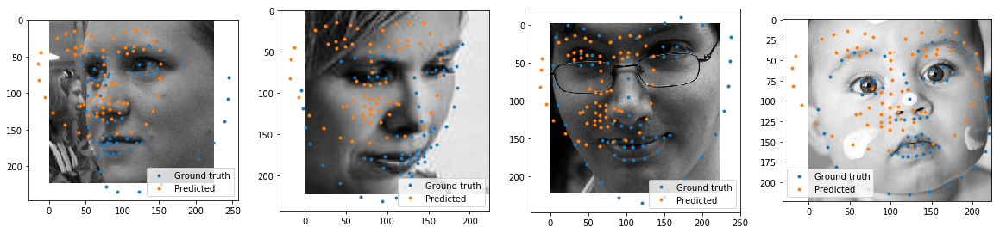

Epoch #0: train_loss = 10867.34


Some test photos


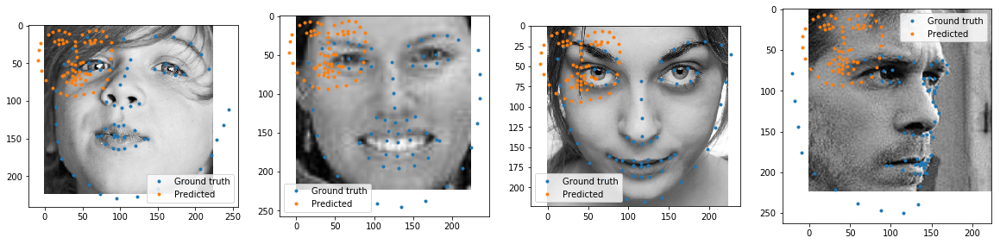

Epoch #0: test_loss = 7139.17
Starting epoch #1!


5 batch loss = 1147.62
10 batch loss = 972.43
15 batch loss = 1119.62
20 batch loss = 906.76
25 batch loss = 564.16
Some train photos


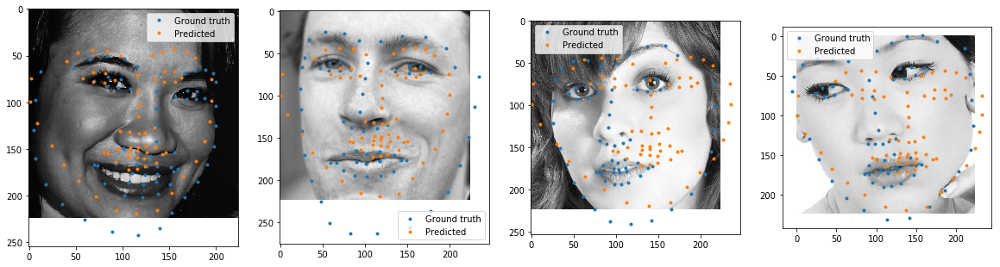

Epoch #1: train_loss = 2152.65


Some test photos


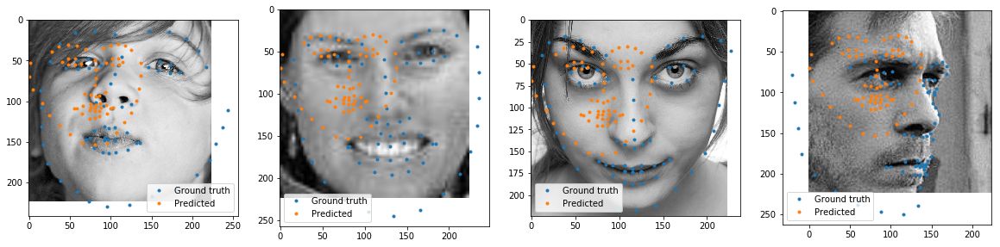

Epoch #1: test_loss = 2403.08
Starting epoch #2!


5 batch loss = 498.13
10 batch loss = 504.11
15 batch loss = 2002.73
20 batch loss = 543.43
25 batch loss = 432.20
Some train photos


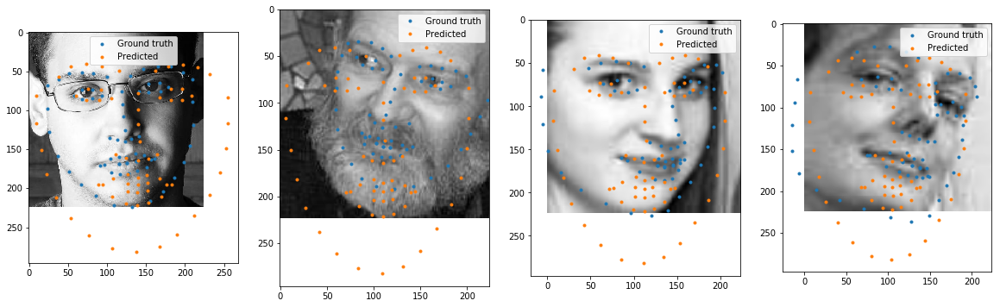

Epoch #2: train_loss = 1744.09


Some test photos


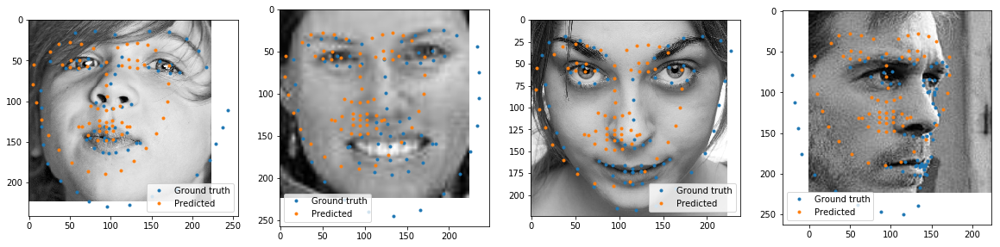

Epoch #2: test_loss = 1133.81
Starting epoch #3!


5 batch loss = 383.14
10 batch loss = 427.88
15 batch loss = 1787.05
20 batch loss = 700.95
25 batch loss = 2309.71
Some train photos


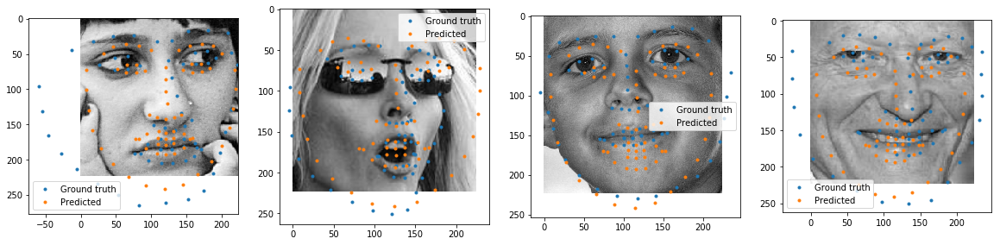

Epoch #3: train_loss = 1663.72


Some test photos


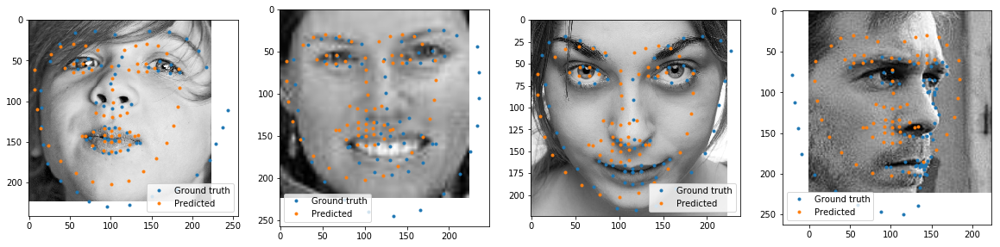

Epoch #3: test_loss = 727.40
lr decreased twice
Starting epoch #4!


5 batch loss = 1570.21
10 batch loss = 696.00
15 batch loss = 1006.86
20 batch loss = 6862.59
25 batch loss = 562.59
Some train photos


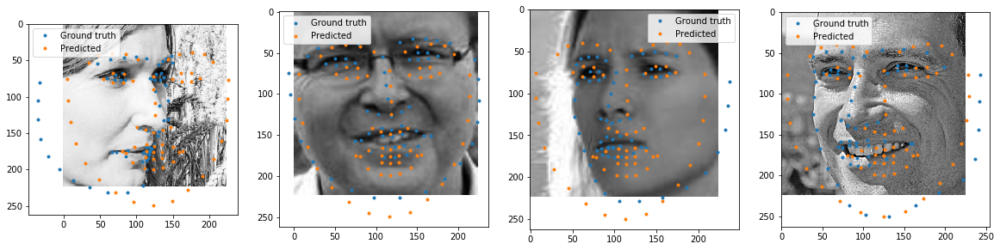

Epoch #4: train_loss = 1618.73


Some test photos


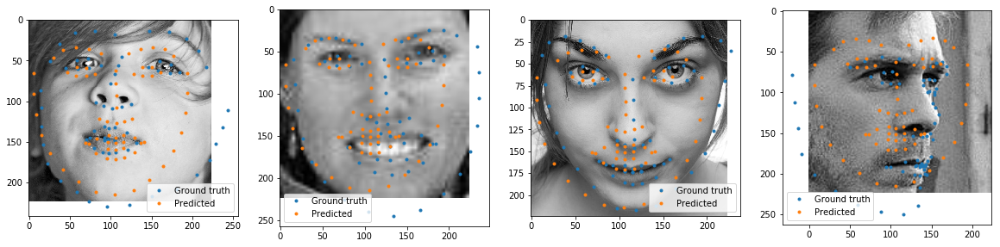

Epoch #4: test_loss = 514.52


In [83]:
train_loss_epoch = []
test_loss_epoch = []

for epoch in tqdm_notebook(range(5)):

    # Обучение
    if (epoch + 1) % 5 == 0:
        for g in opt.param_groups:
            g['lr'] /= 2
            print("lr decreased twice")

    model.train()
    train_loss = []
    print("Starting epoch #%i!" % epoch)
    for n_batch, (X_batch, y_batch) in tqdm_notebook(enumerate(iterate_batches(train_img_paths, train_pts, 
                                                                               BATCH_SIZE, shuffle=True))):
        X_batch_images = []
        y_batch_transformed = np.copy(y_batch)
        for k, img_name in enumerate(X_batch):
            img = imread(CROPPED_IMG_PATH + "train/" + img_name)

            # Трансформируем полученное изображение в одноканальное черно-белое
            img = img2gray(img)

            # Сдвигаем координаты ключевых точек в зависимости от координат прямоугольника
            y_batch_transformed[k] -= shifts_train[CROPPED_IMG_PATH + "train/" + img_name][::-1]

            # Приводим все вырезанные изодражения к одному размеру и соответственно изменяем координаты точек
            X_batch_images.append(torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0))
            y_scale = img.shape[0] / H  
            x_scale = img.shape[1] / W 
            y_batch_transformed[k] /= [x_scale, y_scale]

        X_batch_images = torch.stack(X_batch_images)
        output = model(X_batch_images.cuda())

        loss = mseloss(output, torch.Tensor(list(map(lambda x: x.flatten(), y_batch_transformed))).cuda())
        if (n_batch + 1) % 5 == 0:
            print("%i batch loss = %.2f" % ((n_batch + 1), loss.cpu().item()))

        opt.zero_grad()
        loss.backward()
        opt.step()

        train_loss.append(loss)

    print("Some train photos")
    n_imgs_to_evaluate = min([4, len(X_batch_images)])
    fig, axes = plt.subplots(1, n_imgs_to_evaluate, figsize=(n_imgs_to_evaluate * 5, n_imgs_to_evaluate * 5))
    visualize_results(X_batch_images, y_batch_transformed, output, axes, n_imgs_to_evaluate)

    train_loss_epoch.append((sum(train_loss) / len(train_loss)).item())
    print("Epoch #%i: train_loss = %.2f" % (epoch, train_loss_epoch[-1]))

    # Тестирование
    model.train(False)
    test_loss = []
    for n_batch_test, (X_batch_test, y_batch_test) in tqdm_notebook(enumerate(iterate_batches(test_img_paths, test_pts, 
                                                                                              BATCH_SIZE))):
        with torch.no_grad():
            X_batch_test_images = []
            y_batch_test_transformed = np.copy(y_batch_test)
            for k, img_name in enumerate(X_batch_test):
                img = imread(CROPPED_IMG_PATH + "test/" + img_name)

                if len(img.shape) == 3:
                    img = rgb2gray(img)
                if len(img.shape) == 2:
                    img = img / 255

                y_batch_test_transformed[k] -= shifts_test[CROPPED_IMG_PATH + "test/" + img_name][::-1]

                X_batch_test_images.append(torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0))
                y_scale = img.shape[0] / H
                x_scale = img.shape[1] / W
                y_batch_test_transformed[k] /= [img.shape[0] / H, img.shape[1] / W]

            X_batch_test_images = torch.stack(X_batch_test_images)
            output = model(X_batch_test_images.cuda())

            loss = mseloss(output, torch.Tensor(list(map(lambda x: x.flatten(), y_batch_test_transformed))).cuda())
            test_loss.append(loss)

    # Визуализация результатов
    print("Some test photos")
    n_imgs_to_evaluate = min([4, len(X_batch_test)])
    fig, axes = plt.subplots(1, n_imgs_to_evaluate, figsize=(n_imgs_to_evaluate * 5, n_imgs_to_evaluate * 5))
    visualize_results(X_batch_test_images, y_batch_test_transformed, output, axes, n_imgs_to_evaluate)
    
    test_loss_epoch.append((sum(test_loss) / len(test_loss)).item())
    print("Epoch #%i: test_loss = %.2f" % (epoch, test_loss_epoch[-1]))
    print("============================================================")

**Видим, что на некоторых батчах лосс снизился, а на некоторых остался довольно большим**

**Пробежимся по каждому изображению в трейне и тесте и найдем те, для которых лосс сохранился высоким**

In [129]:
model.train(False)
THRESHOLD_LOSS = 2000.

img_paths = [train_img_paths, test_img_paths]
pts = [train_pts, test_pts]
periods = ["train/", "test/"]
suspicious_images_train = []
suspicious_images_test = []

for img_path, pt, period in tqdm_notebook(zip(img_paths, pts, periods)):
    print(period.upper()[:-1] + " IMAGES:")
    for n_batch, (X_batch, y_batch) in tqdm_notebook(enumerate(iterate_batches(img_path, pt, 1, shuffle=False))):
        with torch.no_grad():
            X_batch_images = []
            y_batch_transformed = np.copy(y_batch)
            for k, img_name in enumerate(X_batch):
                img = imread(CROPPED_IMG_PATH + period + img_name)
                img = img2gray_uint(img)

                if period == "train/":
                    y_batch_transformed[k] -= shifts_train[CROPPED_IMG_PATH + period + img_name][::-1]
                else:
                    y_batch_transformed[k] -= shifts_test[CROPPED_IMG_PATH + period + img_name][::-1]
                X_batch_images.append(torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0))
                y_scale = img.shape[0] / H  
                x_scale = img.shape[1] / W 
                y_batch_transformed[k] /= [x_scale, y_scale]

            X_batch_images = torch.stack(X_batch_images)
            output = model(X_batch_images.cuda())

            loss = mseloss(output, torch.Tensor(list(map(lambda x: x.flatten(), y_batch_transformed))).cuda())

            if loss.item() > THRESHOLD_LOSS:
                suspicious_images_train.append(img_name) if period == "train/" else suspicious_images_test.append(img_name)

TRAIN IMAGES:


TEST IMAGES:


In [130]:
len(suspicious_images_train), len(suspicious_images_test)

(53, 1)

**Посмотрим на некоторые из подозрительных картинок**

TRAIN:


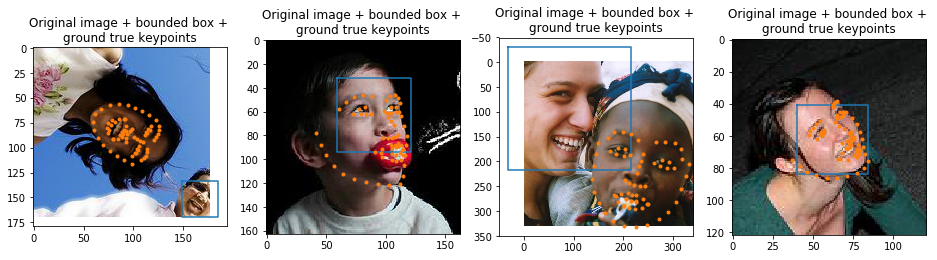

TEST:


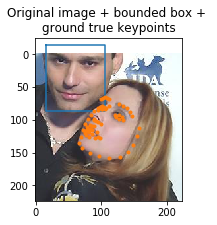

In [176]:
suspicious_images = [suspicious_images_train, suspicious_images_test]

for suspicious_images_period, period in zip(suspicious_images, periods):
    print(period.upper()[:-1] + ":")
    if period == "train/":
        n_suspicious_images = len(suspicious_images_train)
        n_imgs_to_show = min([n_suspicious_images, 4])
    else:
        n_suspicious_images = len(suspicious_images_test)
        n_imgs_to_show = min([n_suspicious_images, 4])
        
    fig, axes = plt.subplots(1, n_imgs_to_show, figsize=(n_imgs_to_show * 4, n_imgs_to_show * 3))
    for n_img, i in enumerate(np.random.choice(n_suspicious_images, n_imgs_to_show)):
        img = imread(IMG_PATH + period + suspicious_images_period[i])
        img_cropped = imread(CROPPED_IMG_PATH + period + suspicious_images_period[i])

        dets = detector(img, 1)
        d = dets[0]
        
        if n_imgs_to_show == 1:
            axes = [axes]
        axes[n_img].imshow(img, cmap="gray")
        axes[n_img].set_title("Original image + bounded box + \nground true keypoints")
        axes[n_img].plot([d.left(), d.right(), d.right(), d.left(), d.left()], 
                         [d.top(), d.top(), d.bottom(), d.bottom(), d.top()])
        keypoints = extract_keypoints(ATTR_PATH + period + suspicious_images_period[i][:-3] + "pts")
        axes[n_img].plot(keypoints[:, 0], keypoints[:, 1], '.')
    plt.show()

**Можно видеть, что такая большая ошибка в большинстве случаев связана с неверной работой детектора лиц и со сложной позицией головы**

**Удалим все такие примеры**

In [178]:
for suspicious_images_period, period in zip(suspicious_images, periods):
    for i in range(len(suspicious_images_period)):
        if os.path.exists(IMG_PATH + period + suspicious_images_period[i]):
            os.remove(IMG_PATH + period + suspicious_images_period[i])

        if os.path.exists(CROPPED_IMG_PATH + period + suspicious_images_period[i]):
            os.remove(CROPPED_IMG_PATH + period + suspicious_images_period[i])

        if os.path.exists(ATTR_PATH + period + suspicious_images_period[i]):
            os.remove(ATTR_PATH + period + suspicious_images_period[i])

**Удалив плохие примеры, снова зададим train и test данные**

**Train**

In [181]:
train_img_paths = [file for file in os.listdir(IMG_PATH + "train/") if re.findall(".jpg", file)]
train_pts = [extract_keypoints(ATTR_PATH + "train/" + file[:-3] + "pts") for file in train_img_paths]

**Test**

In [182]:
test_img_paths = [file for file in os.listdir(IMG_PATH + "test/") if re.findall(".jpg", file)]
test_pts = [extract_keypoints(ATTR_PATH + "test/" + file[:-3] + "pts") for file in test_img_paths]

**Запустим обучение снова, но теперь на более длительное время**

In [185]:
model = ONet()
model.cuda()
opt = Adam(model.parameters(), lr=2e-3)
mseloss = MSELoss()

Starting epoch #0!


5 batch loss = 16878.09
10 batch loss = 3150.02
15 batch loss = 933.64
20 batch loss = 1406.60
25 batch loss = 1339.79
Some train photos


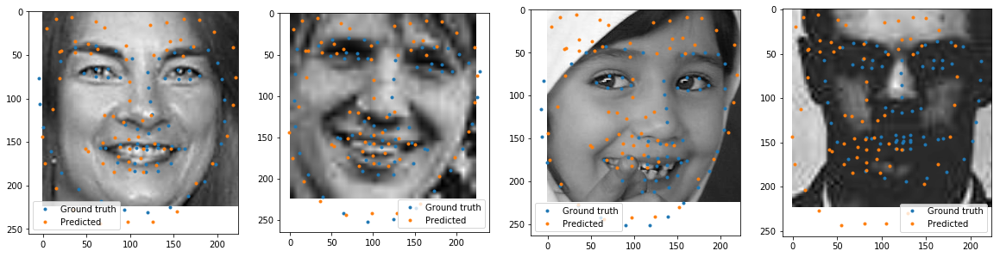

Epoch #0: train_loss = 6361.08


Some test photos


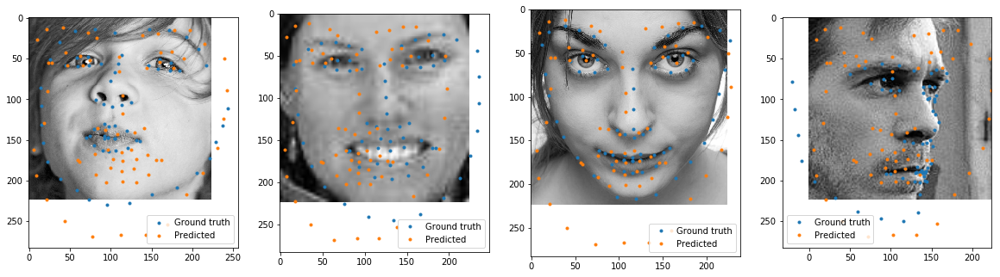

Epoch #0: test_loss = 917.69
Starting epoch #1!


5 batch loss = 612.58
10 batch loss = 625.41
15 batch loss = 567.38
20 batch loss = 520.44
25 batch loss = 484.88
Some train photos


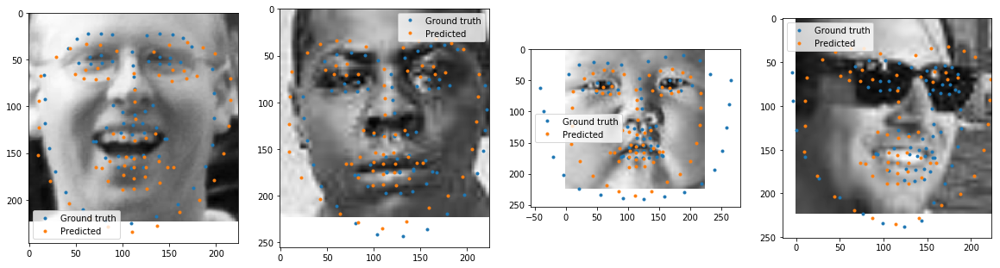

Epoch #1: train_loss = 601.35


Some test photos


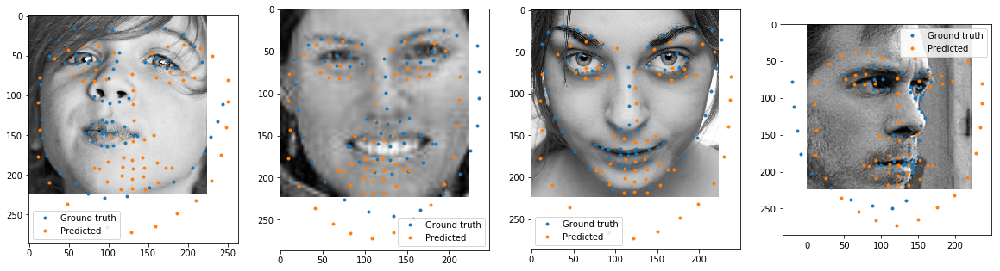

Epoch #1: test_loss = 441.52
Starting epoch #2!


5 batch loss = 433.14
10 batch loss = 388.94
15 batch loss = 367.83
20 batch loss = 402.14
25 batch loss = 365.81
Some train photos


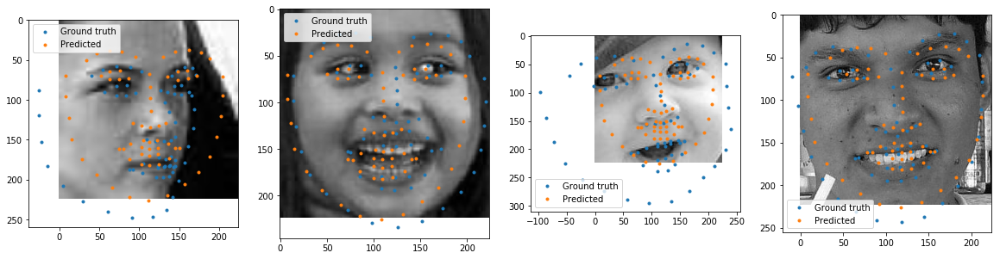

Epoch #2: train_loss = 405.39


Some test photos


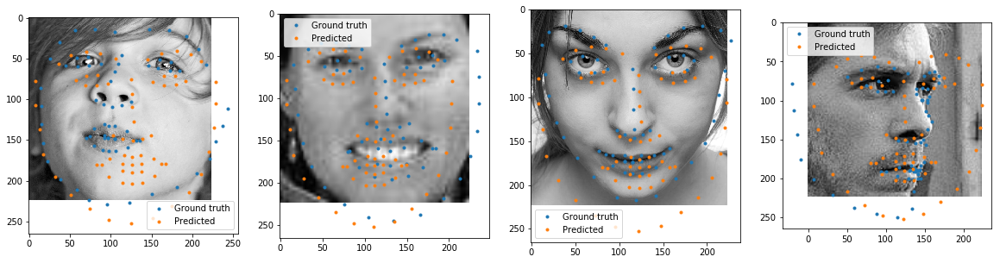

Epoch #2: test_loss = 378.48
Starting epoch #3!


5 batch loss = 366.88
10 batch loss = 323.17
15 batch loss = 323.88
20 batch loss = 326.23
25 batch loss = 320.77
Some train photos


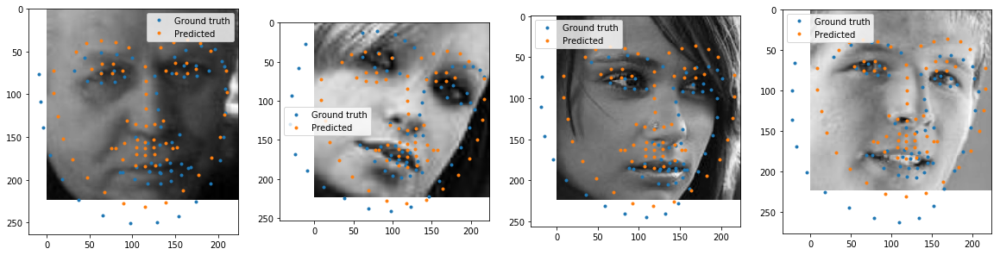

Epoch #3: train_loss = 331.04


Some test photos


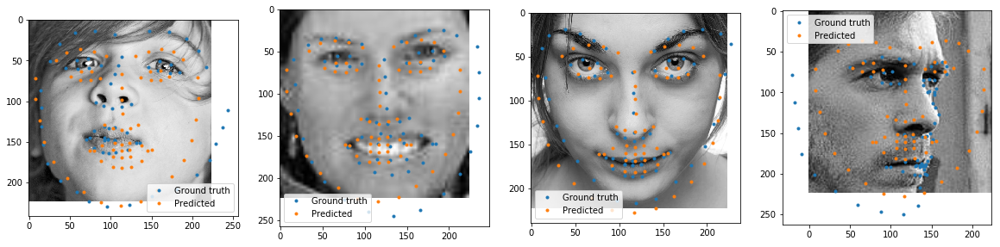

Epoch #3: test_loss = 328.58
Starting epoch #4!


5 batch loss = 308.95
10 batch loss = 317.99
15 batch loss = 347.70
20 batch loss = 315.09
25 batch loss = 309.24
Some train photos


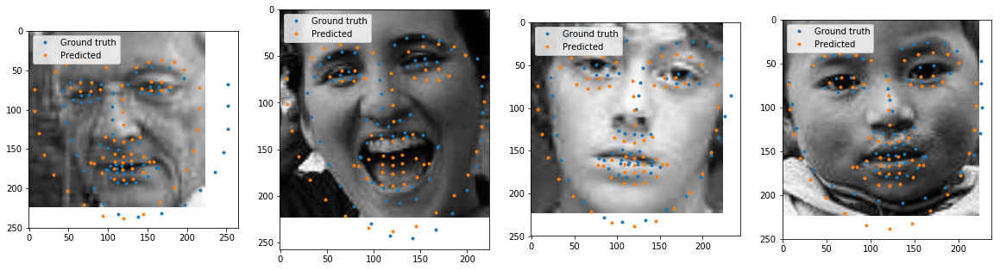

Epoch #4: train_loss = 316.80


Some test photos


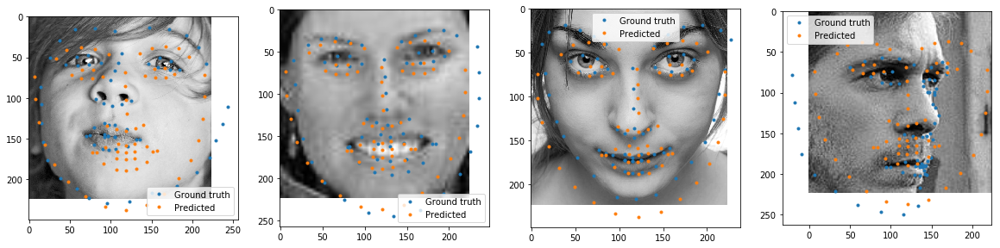

Epoch #4: test_loss = 330.84
Starting epoch #5!


5 batch loss = 323.81
10 batch loss = 325.72
15 batch loss = 332.72
20 batch loss = 318.50
25 batch loss = 327.16
Some train photos


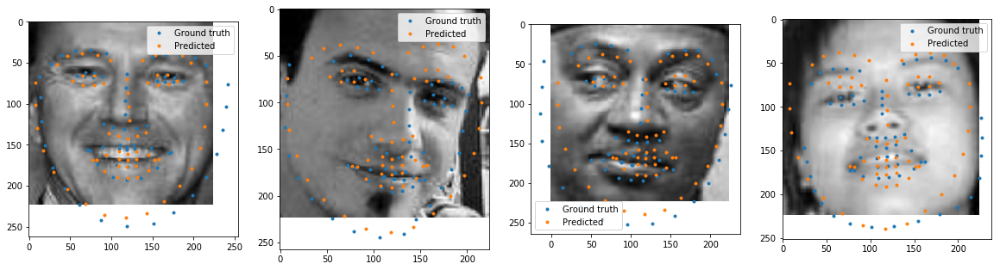

Epoch #5: train_loss = 316.51


Some test photos


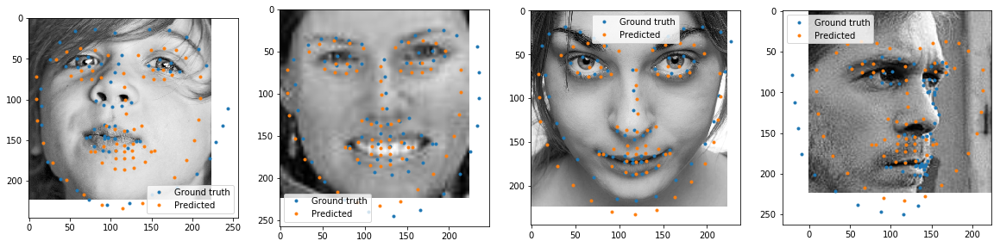

Epoch #5: test_loss = 325.49
lr decreased twice
Starting epoch #6!


5 batch loss = 307.48
10 batch loss = 305.52
15 batch loss = 296.10
20 batch loss = 312.81
25 batch loss = 284.46
Some train photos


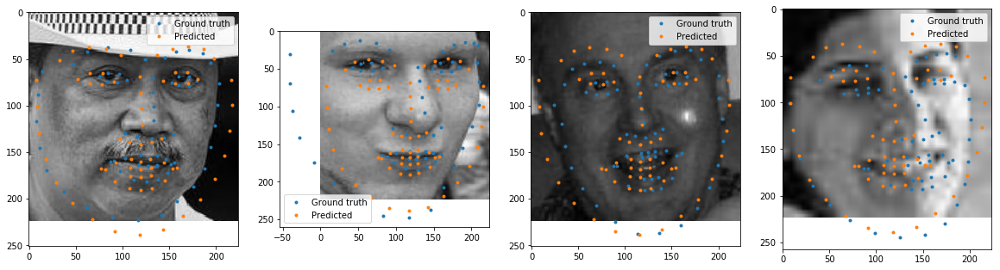

Epoch #6: train_loss = 315.03


Some test photos


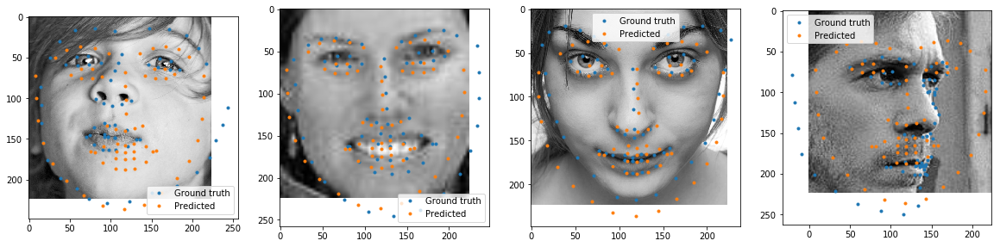

Epoch #6: test_loss = 326.46
Starting epoch #7!


5 batch loss = 319.26
10 batch loss = 321.18
15 batch loss = 319.30
20 batch loss = 328.96
25 batch loss = 343.23
Some train photos


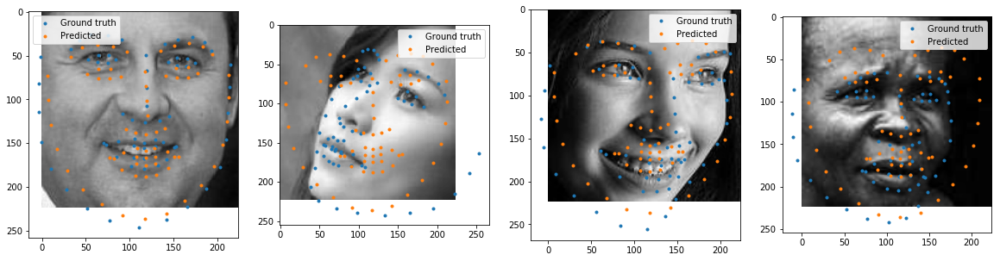

Epoch #7: train_loss = 315.06


Some test photos


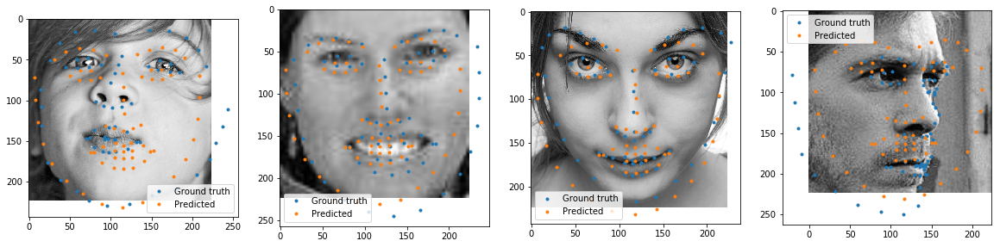

Epoch #7: test_loss = 325.60
Starting epoch #8!


5 batch loss = 286.55
10 batch loss = 299.59
15 batch loss = 317.30
20 batch loss = 311.79
25 batch loss = 293.90
Some train photos


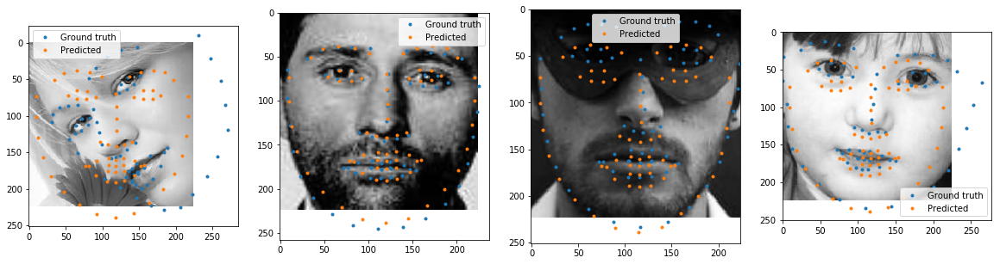

Epoch #8: train_loss = 314.25


Some test photos


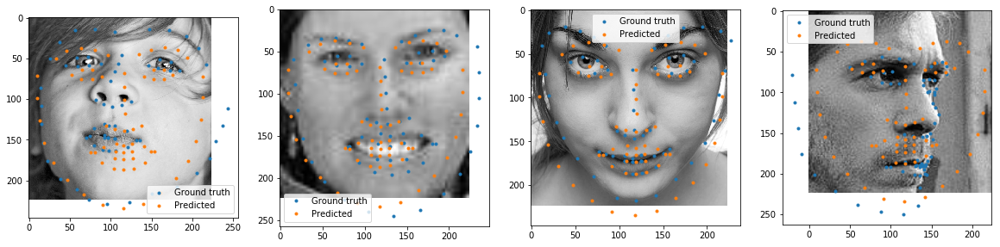

Epoch #8: test_loss = 324.60
Starting epoch #9!


5 batch loss = 314.54
10 batch loss = 322.45
15 batch loss = 300.16
20 batch loss = 312.26
25 batch loss = 314.23
Some train photos


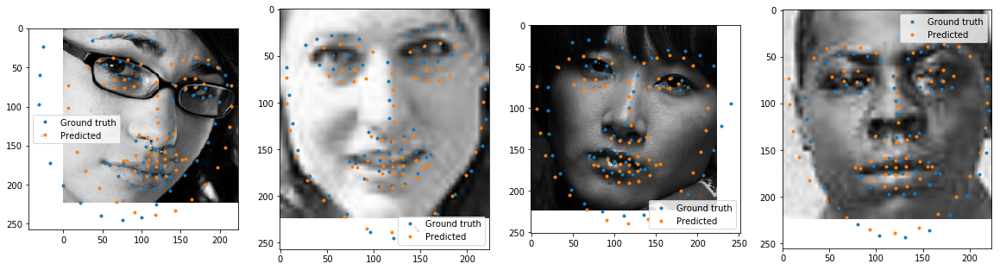

Epoch #9: train_loss = 313.97


Some test photos


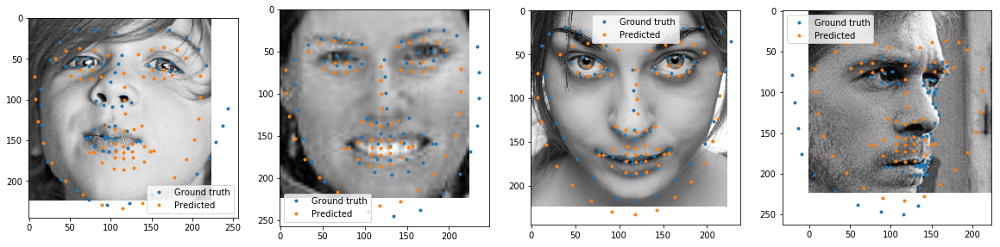

Epoch #9: test_loss = 324.30
Starting epoch #10!


5 batch loss = 312.48
10 batch loss = 330.91
15 batch loss = 326.05
20 batch loss = 329.50
25 batch loss = 326.22
Some train photos


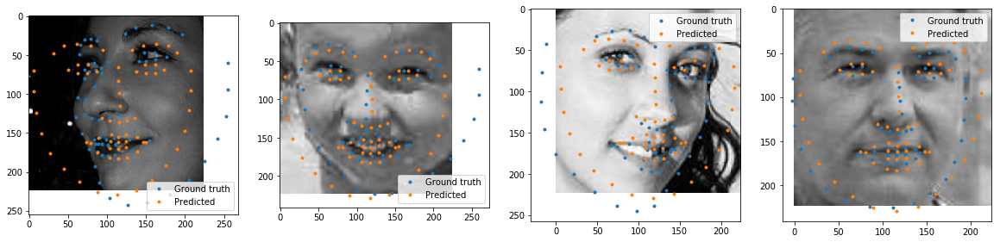

Epoch #10: train_loss = 314.09


Some test photos


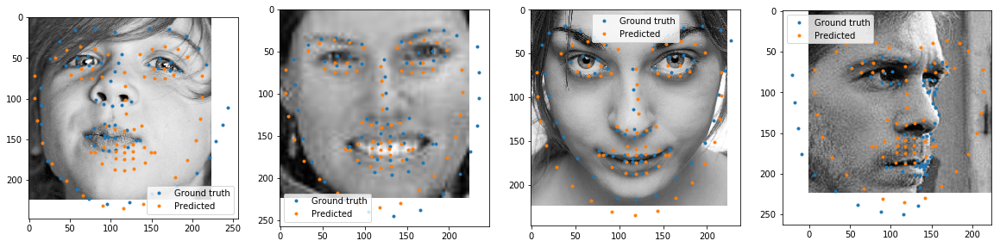

Epoch #10: test_loss = 324.61
Starting epoch #11!


5 batch loss = 314.00
10 batch loss = 315.58
15 batch loss = 302.04
20 batch loss = 310.77
25 batch loss = 319.86
Some train photos


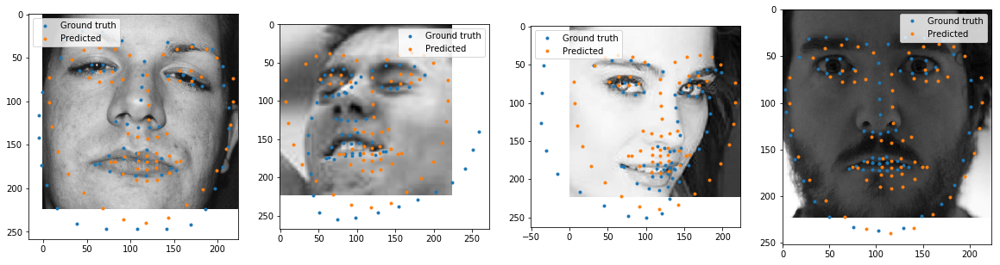

Epoch #11: train_loss = 314.07


Some test photos


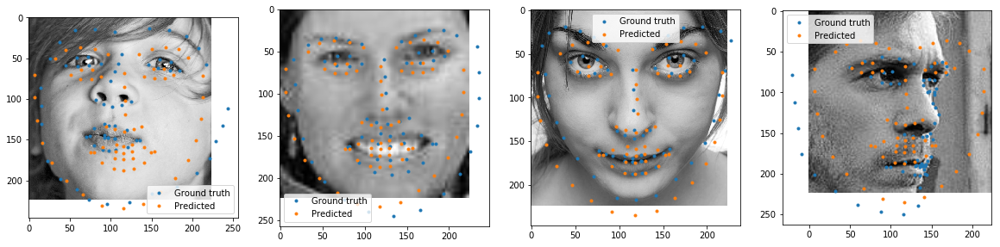

Epoch #11: test_loss = 324.36
Starting epoch #12!


5 batch loss = 324.79
10 batch loss = 306.39
15 batch loss = 307.14
20 batch loss = 314.99
25 batch loss = 339.87
Some train photos


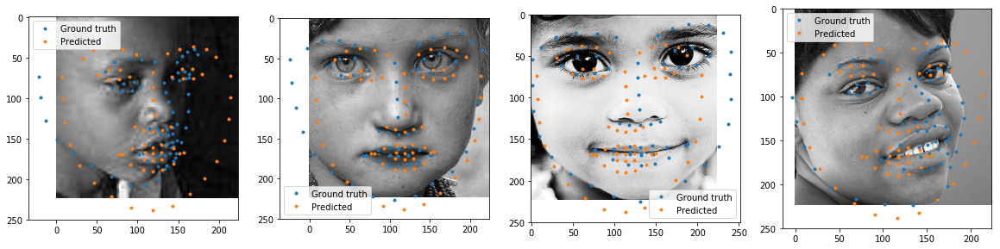

Epoch #12: train_loss = 314.06


Some test photos


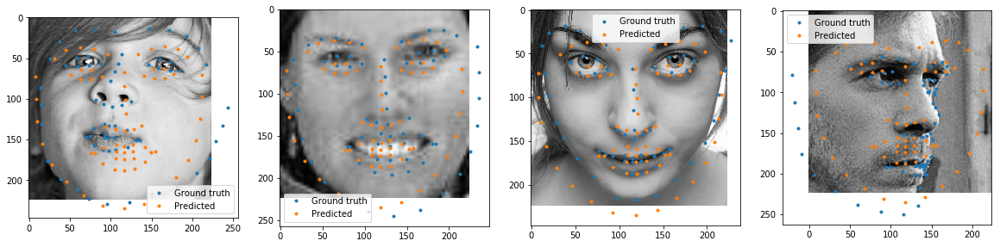

Epoch #12: test_loss = 324.43
lr decreased twice
Starting epoch #13!


5 batch loss = 309.14
10 batch loss = 302.39
15 batch loss = 324.25
20 batch loss = 326.97
25 batch loss = 319.26
Some train photos


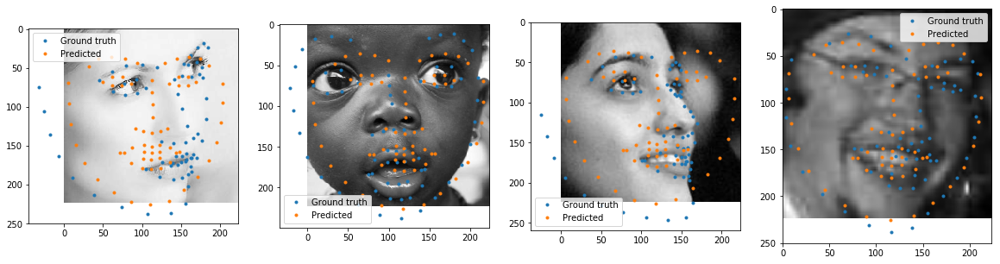

Epoch #13: train_loss = 313.77


Some test photos


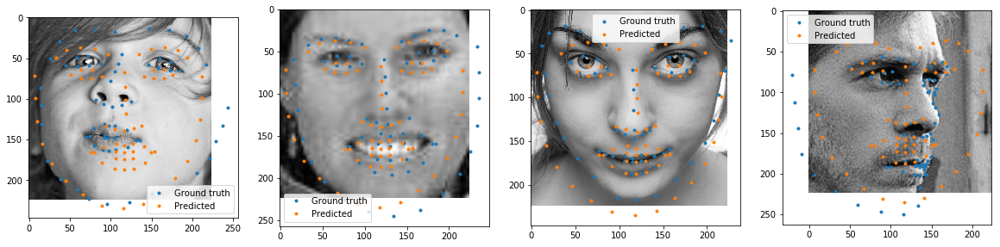

Epoch #13: test_loss = 324.05
Starting epoch #14!


5 batch loss = 283.58
10 batch loss = 289.33
15 batch loss = 289.04
20 batch loss = 343.26
25 batch loss = 303.71
Some train photos


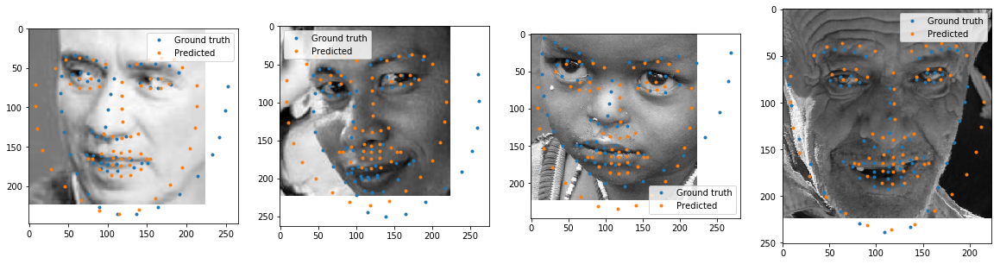

Epoch #14: train_loss = 313.90


Some test photos


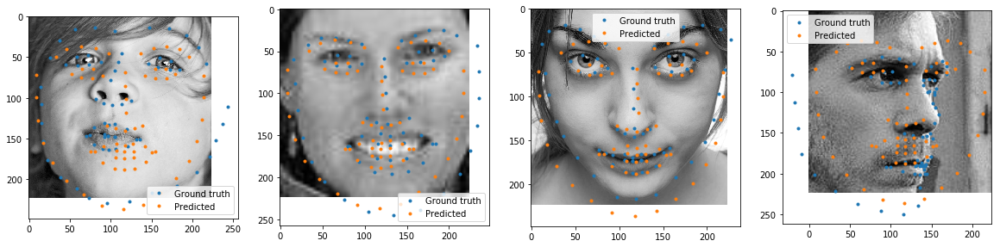

Epoch #14: test_loss = 325.28
Starting epoch #15!


5 batch loss = 329.69
10 batch loss = 302.40
15 batch loss = 322.39
20 batch loss = 322.81
25 batch loss = 334.08
Some train photos


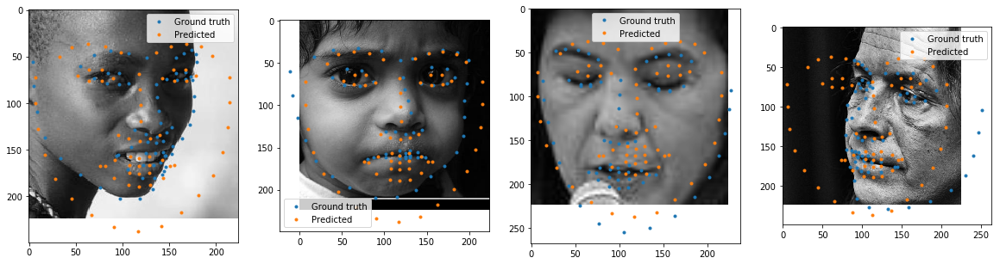

Epoch #15: train_loss = 313.33


Some test photos


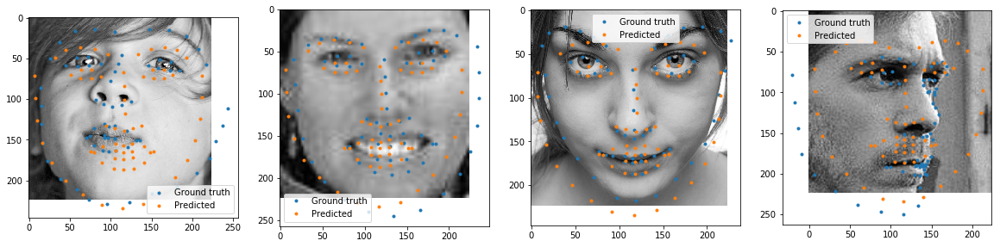

Epoch #15: test_loss = 323.17
Starting epoch #16!


5 batch loss = 300.54
10 batch loss = 291.55
15 batch loss = 301.59
20 batch loss = 309.16
25 batch loss = 306.20
Some train photos


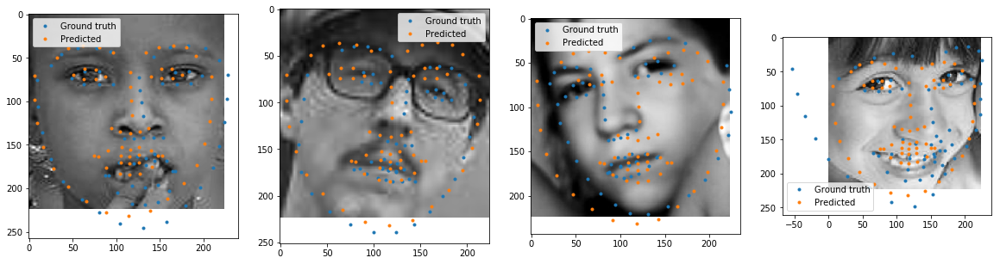

Epoch #16: train_loss = 312.86


Some test photos


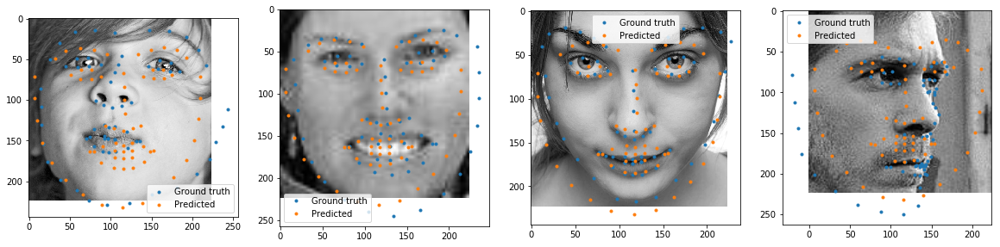

Epoch #16: test_loss = 323.56
Starting epoch #17!


5 batch loss = 302.17
10 batch loss = 322.49
15 batch loss = 317.32
20 batch loss = 325.87
25 batch loss = 335.84
Some train photos


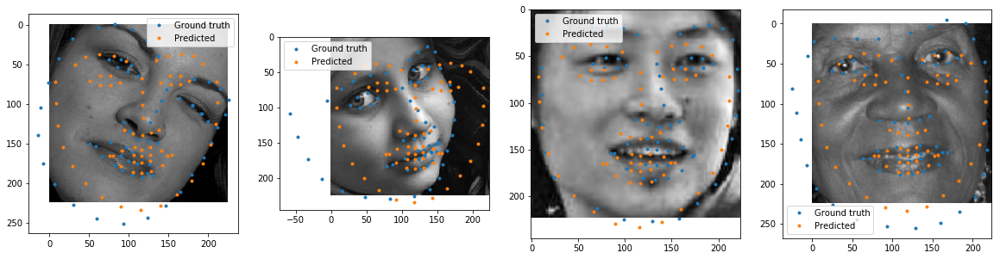

Epoch #17: train_loss = 313.13


Some test photos


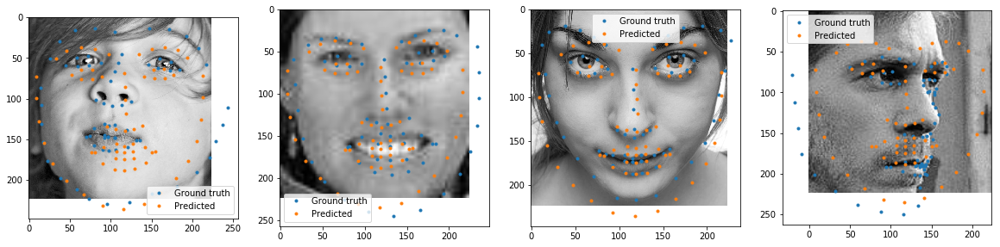

Epoch #17: test_loss = 323.64
Starting epoch #18!


5 batch loss = 311.16
10 batch loss = 328.87
15 batch loss = 277.32
20 batch loss = 302.92
25 batch loss = 303.52
Some train photos


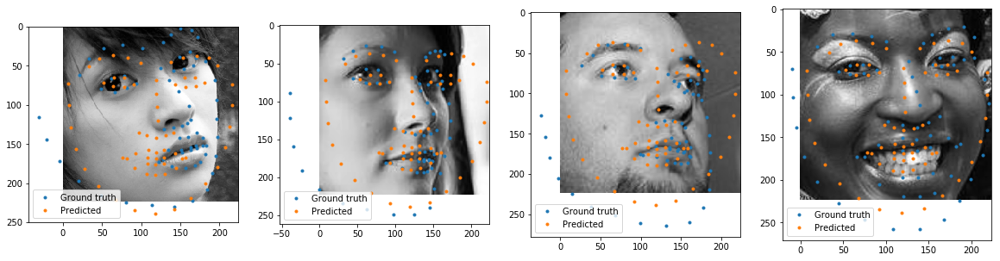

Epoch #18: train_loss = 313.29


Some test photos


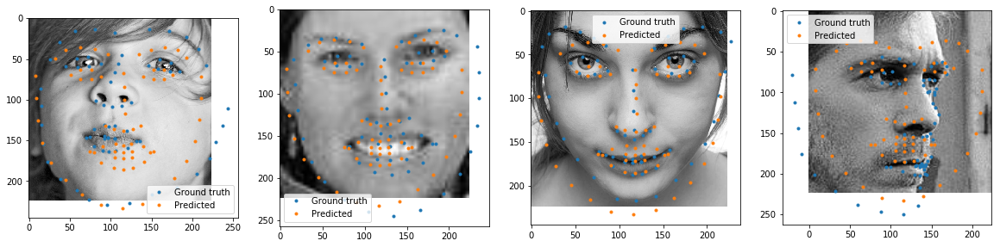

Epoch #18: test_loss = 323.16
Starting epoch #19!


5 batch loss = 281.91
10 batch loss = 303.88
15 batch loss = 324.52
20 batch loss = 323.47
25 batch loss = 317.46
Some train photos


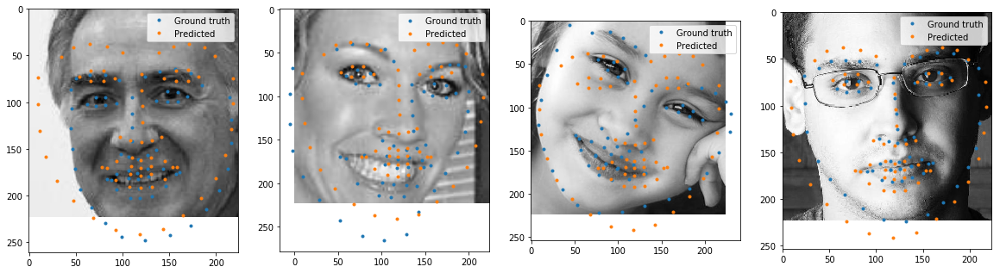

Epoch #19: train_loss = 312.93


Some test photos


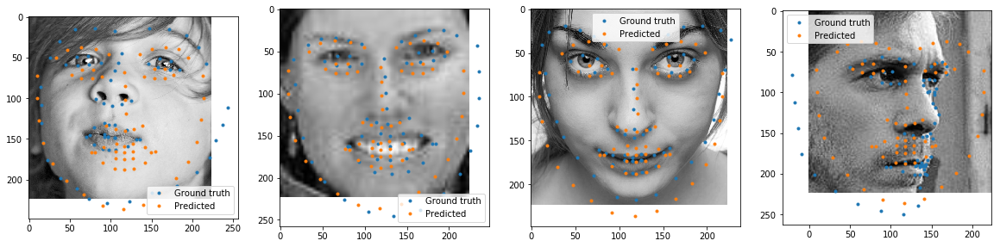

Epoch #19: test_loss = 324.37
lr decreased twice
Starting epoch #20!


5 batch loss = 288.65
10 batch loss = 326.18
15 batch loss = 321.26
20 batch loss = 329.48
25 batch loss = 331.81
Some train photos


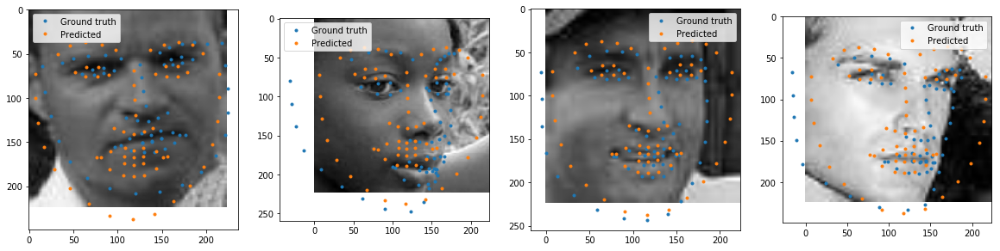

Epoch #20: train_loss = 312.67


Some test photos


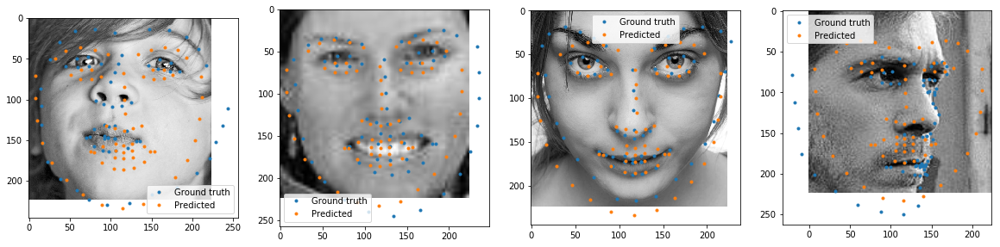

Epoch #20: test_loss = 322.91
Starting epoch #21!


5 batch loss = 321.25
10 batch loss = 317.00
15 batch loss = 320.41
20 batch loss = 305.33
25 batch loss = 330.30
Some train photos


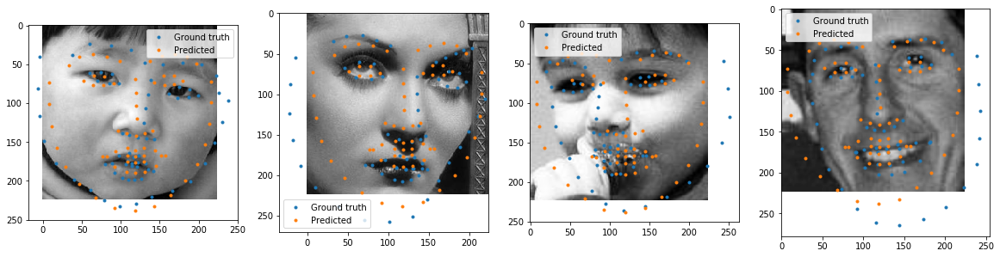

Epoch #21: train_loss = 312.42


Some test photos


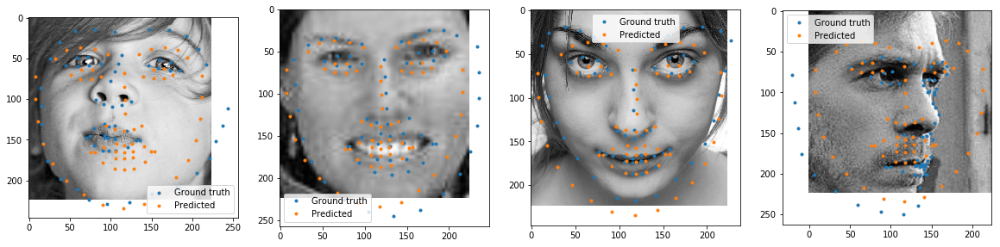

Epoch #21: test_loss = 322.96
Starting epoch #22!


5 batch loss = 303.90
10 batch loss = 291.85
15 batch loss = 317.65
20 batch loss = 328.66
25 batch loss = 310.32
Some train photos


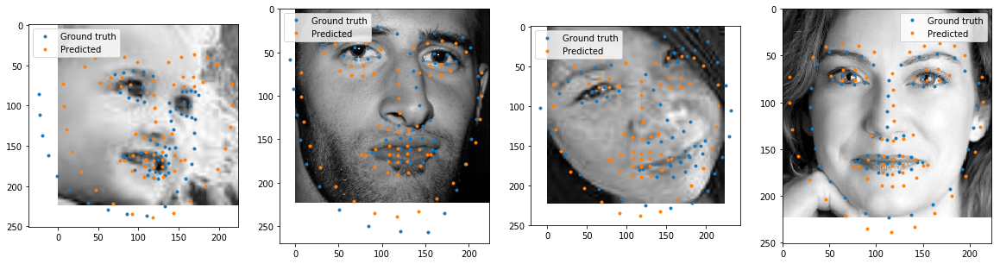

Epoch #22: train_loss = 312.47


Some test photos


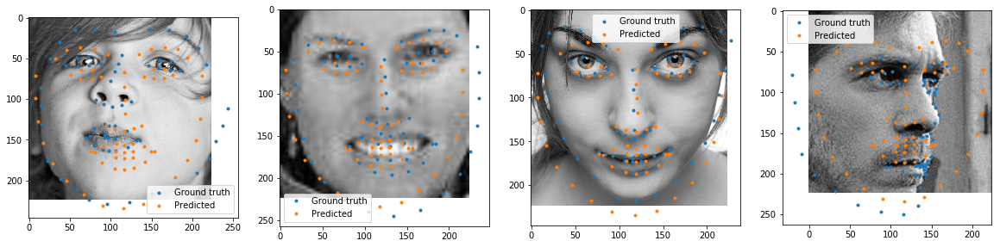

Epoch #22: test_loss = 322.83
Starting epoch #23!


5 batch loss = 338.74
10 batch loss = 283.15
15 batch loss = 354.56
20 batch loss = 342.89
25 batch loss = 300.64
Some train photos


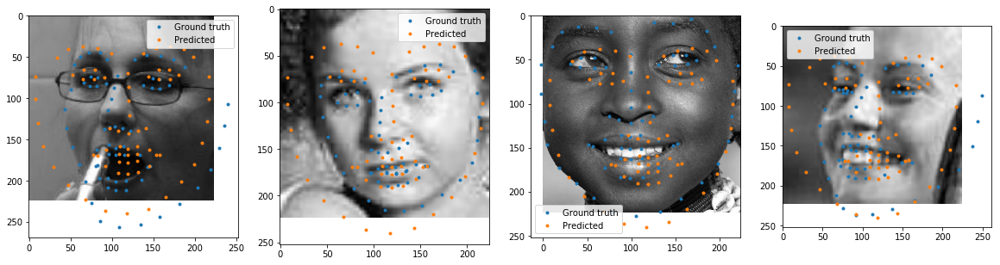

Epoch #23: train_loss = 312.58


Some test photos


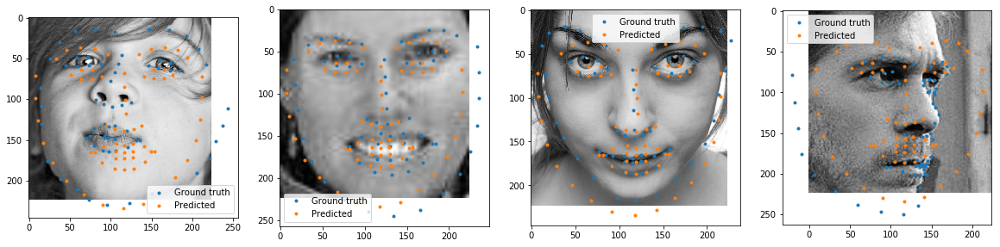

Epoch #23: test_loss = 322.79
Starting epoch #24!


5 batch loss = 308.53
10 batch loss = 290.13
15 batch loss = 311.40
20 batch loss = 327.17
25 batch loss = 316.64
Some train photos


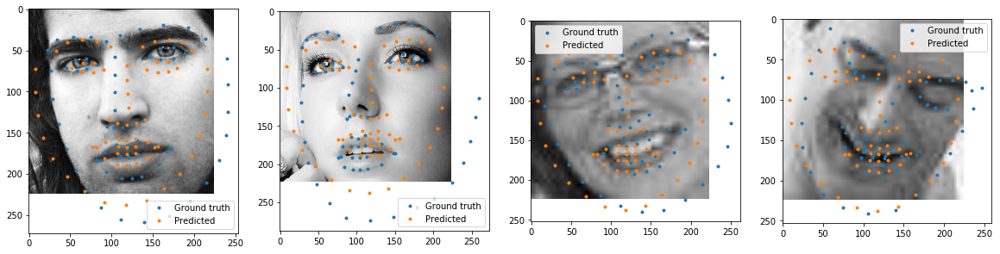

Epoch #24: train_loss = 312.45


Some test photos


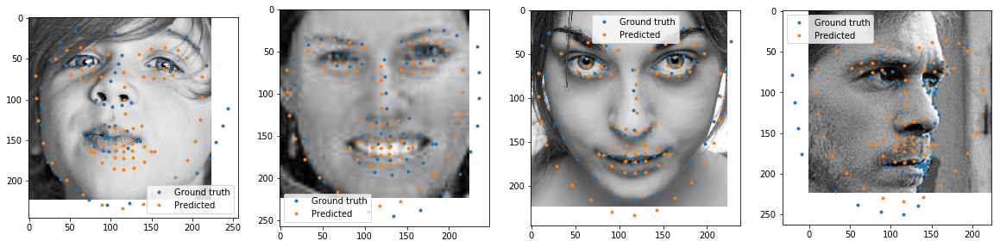

Epoch #24: test_loss = 322.64
Starting epoch #25!


5 batch loss = 293.22
10 batch loss = 288.23
15 batch loss = 321.60
20 batch loss = 331.13
25 batch loss = 321.82
Some train photos


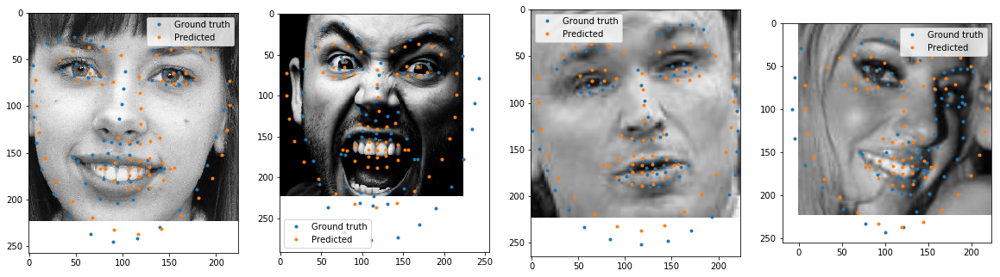

Epoch #25: train_loss = 312.31


Some test photos


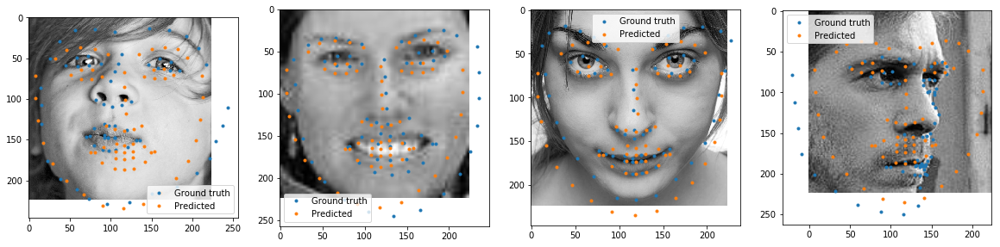

Epoch #25: test_loss = 322.92
Starting epoch #26!


5 batch loss = 288.80
10 batch loss = 300.26
15 batch loss = 294.86
20 batch loss = 324.47
25 batch loss = 313.46
Some train photos


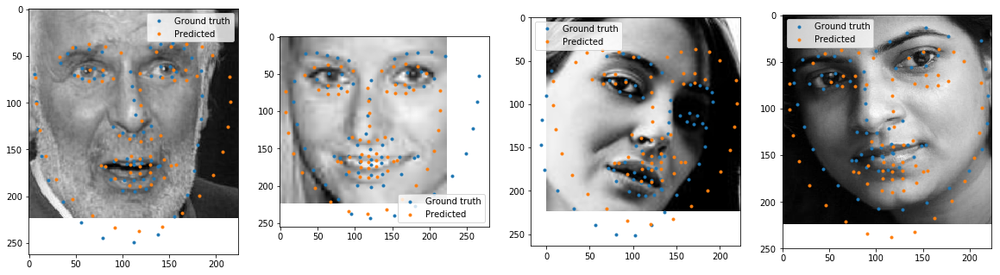

Epoch #26: train_loss = 312.29


Some test photos


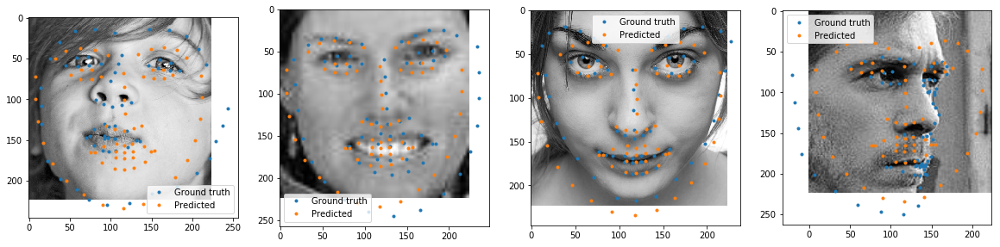

Epoch #26: test_loss = 322.66
lr decreased twice
Starting epoch #27!


5 batch loss = 316.86
10 batch loss = 311.94
15 batch loss = 292.05
20 batch loss = 299.81
25 batch loss = 314.43
Some train photos


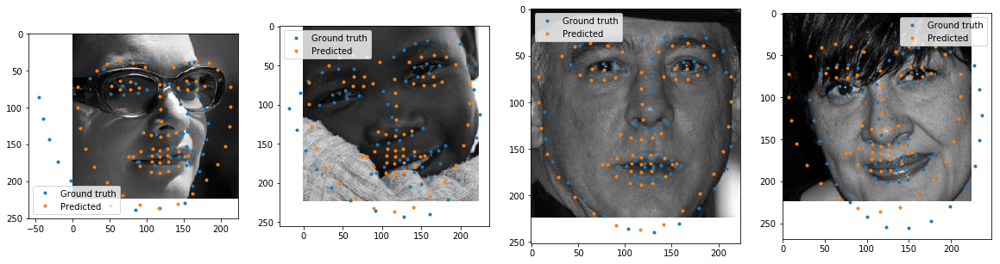

Epoch #27: train_loss = 312.15


Some test photos


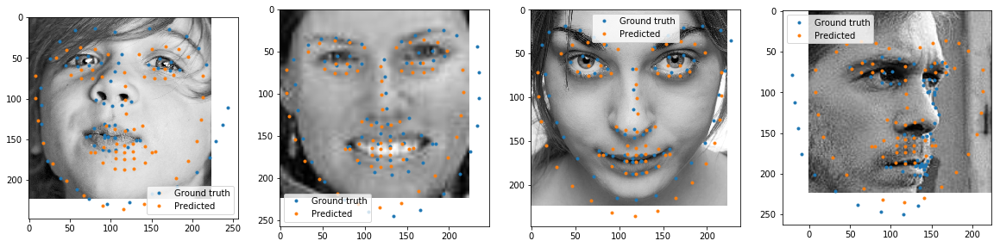

Epoch #27: test_loss = 323.02
Starting epoch #28!


5 batch loss = 322.81
10 batch loss = 338.50
15 batch loss = 301.81
20 batch loss = 300.64
25 batch loss = 295.60
Some train photos


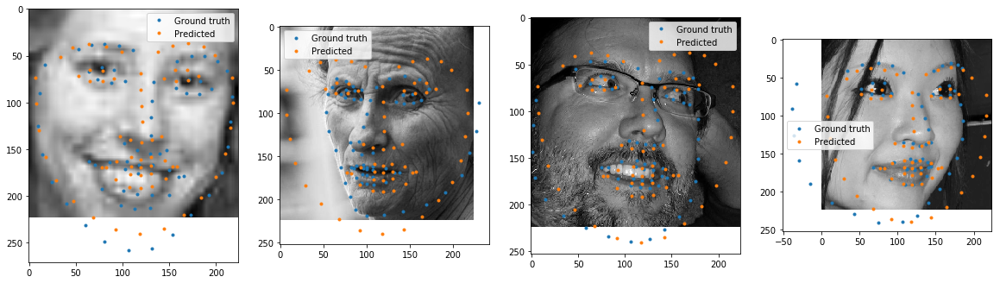

Epoch #28: train_loss = 312.22


Some test photos


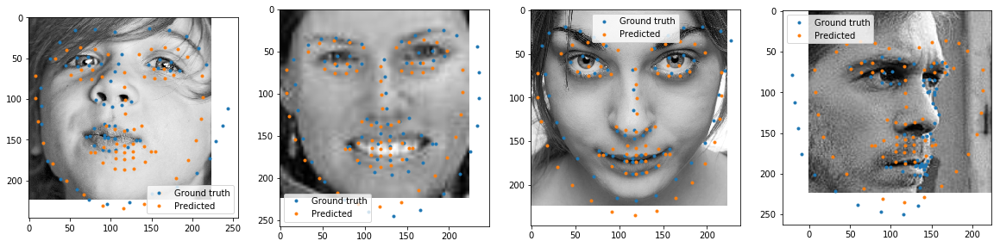

Epoch #28: test_loss = 322.58
Starting epoch #29!


5 batch loss = 325.04
10 batch loss = 309.64
15 batch loss = 311.85
20 batch loss = 322.40
25 batch loss = 297.72
Some train photos


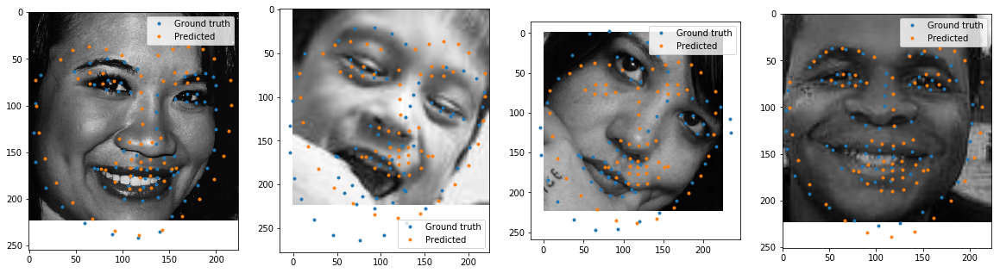

Epoch #29: train_loss = 312.00


Some test photos


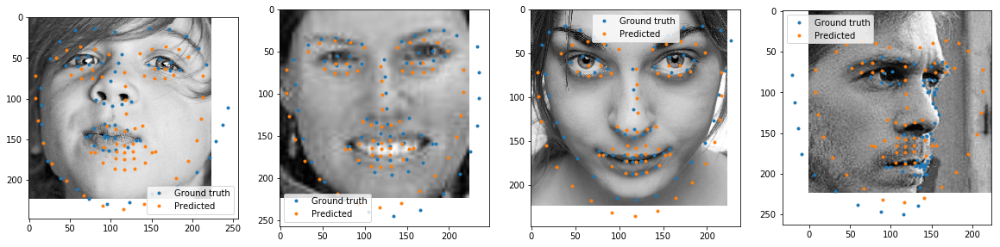

Epoch #29: test_loss = 323.16
Starting epoch #30!


5 batch loss = 298.98
10 batch loss = 297.87
15 batch loss = 303.31
20 batch loss = 293.96
25 batch loss = 314.86
Some train photos


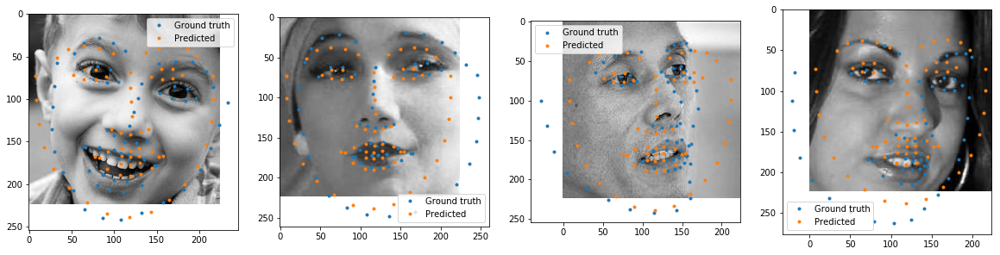

Epoch #30: train_loss = 312.33


Some test photos


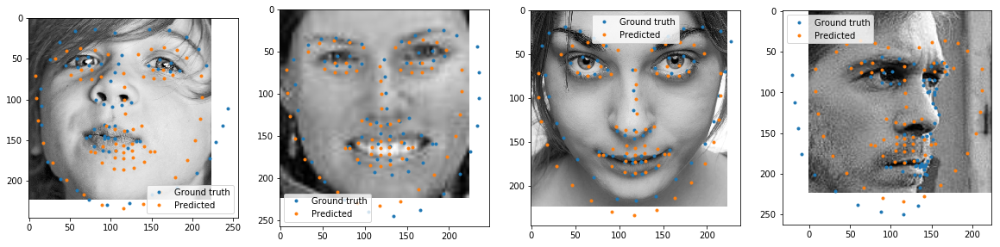

Epoch #30: test_loss = 322.46
Starting epoch #31!


5 batch loss = 316.72
10 batch loss = 306.03
15 batch loss = 328.28
20 batch loss = 322.34
25 batch loss = 334.18
Some train photos


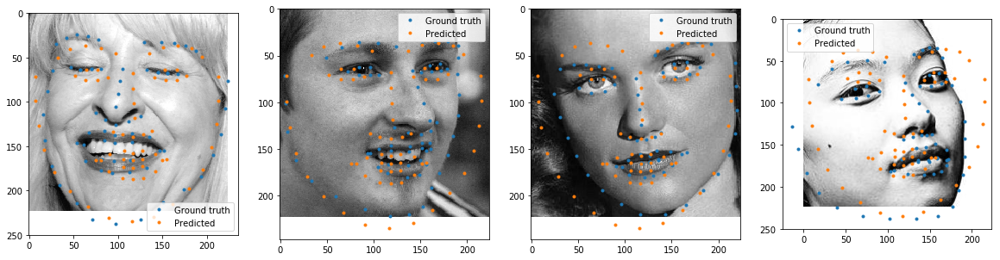

Epoch #31: train_loss = 312.29


Some test photos


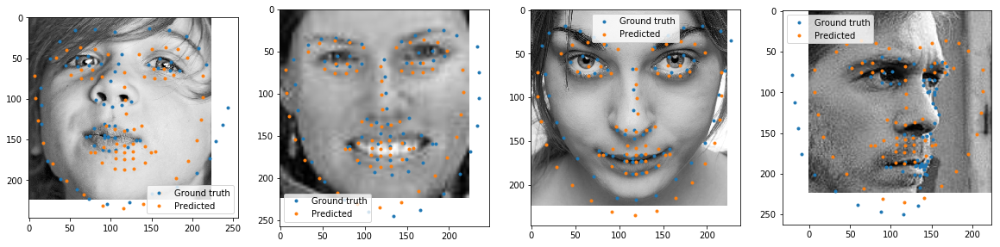

Epoch #31: test_loss = 322.68
Starting epoch #32!


5 batch loss = 321.01
10 batch loss = 311.76
15 batch loss = 312.54
20 batch loss = 324.24
25 batch loss = 330.30
Some train photos


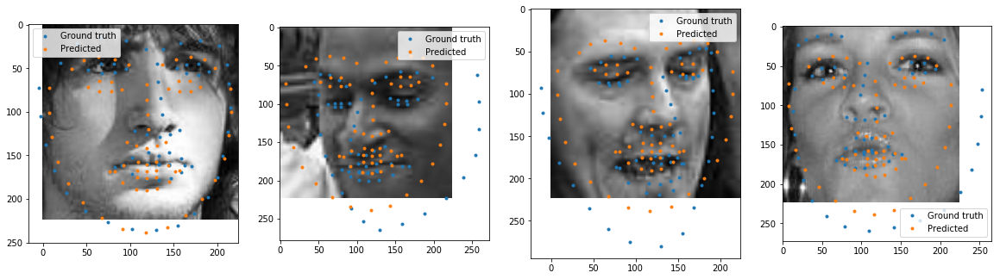

Epoch #32: train_loss = 312.09


Some test photos


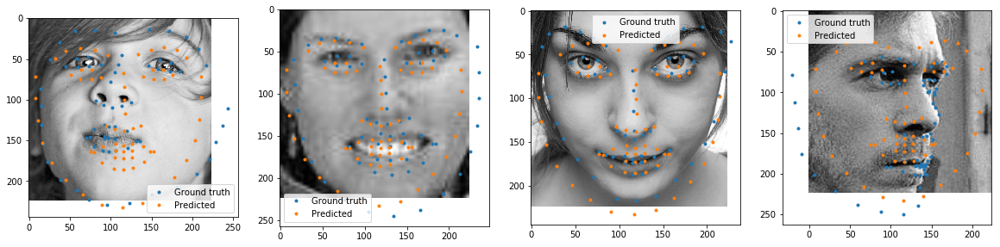

Epoch #32: test_loss = 322.59
Starting epoch #33!


5 batch loss = 309.01
10 batch loss = 330.37
15 batch loss = 301.01
20 batch loss = 298.65
25 batch loss = 320.98
Some train photos


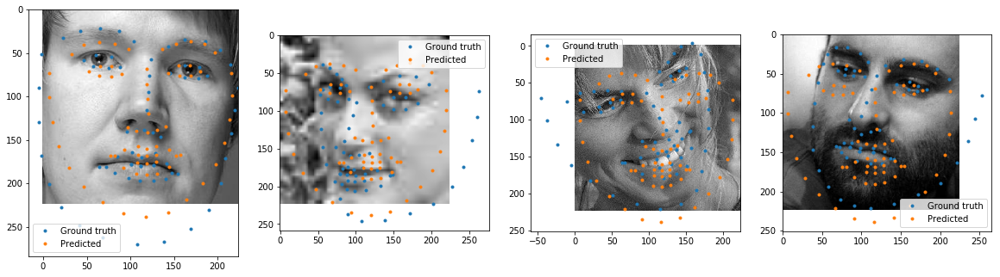

Epoch #33: train_loss = 312.29


Some test photos


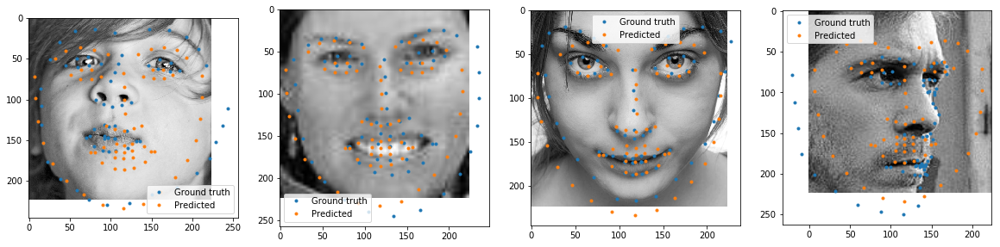

Epoch #33: test_loss = 322.48
lr decreased twice
Starting epoch #34!


5 batch loss = 306.19
10 batch loss = 326.48
15 batch loss = 317.29
20 batch loss = 311.74
25 batch loss = 316.64
Some train photos


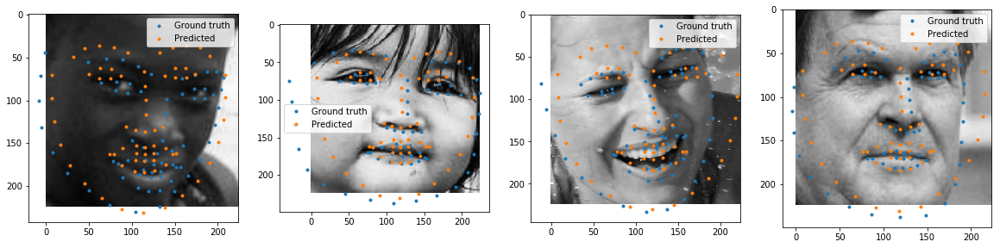

Epoch #34: train_loss = 312.00


Some test photos


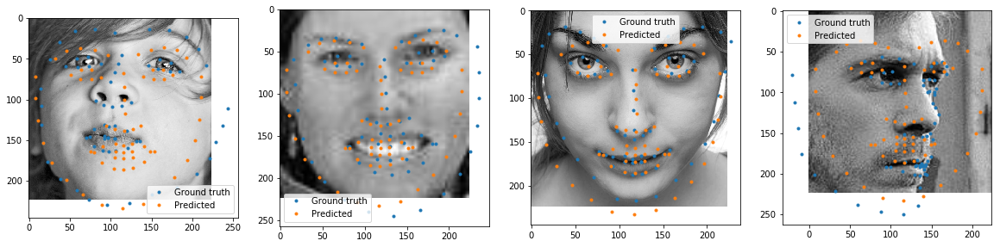

Epoch #34: test_loss = 322.46
Starting epoch #35!


5 batch loss = 281.13
10 batch loss = 313.46
15 batch loss = 331.13
20 batch loss = 309.39
25 batch loss = 336.29
Some train photos


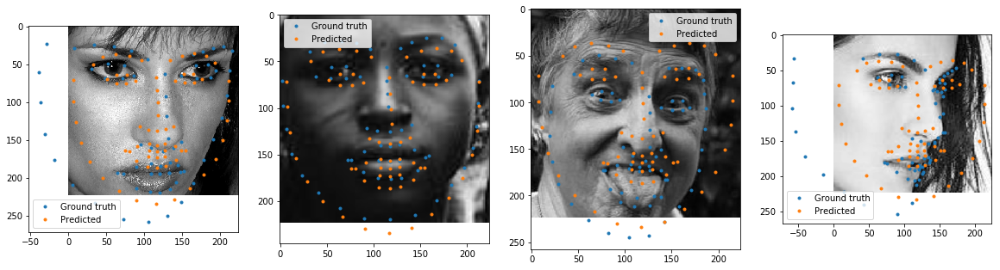

Epoch #35: train_loss = 311.86


Some test photos


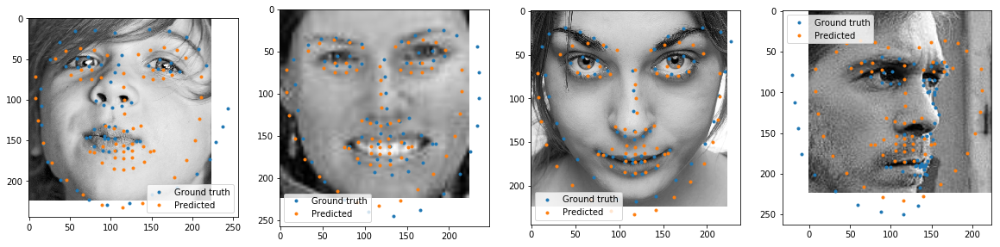

Epoch #35: test_loss = 322.60
Starting epoch #36!


5 batch loss = 313.21
10 batch loss = 308.46
15 batch loss = 327.34
20 batch loss = 297.28
25 batch loss = 312.99
Some train photos


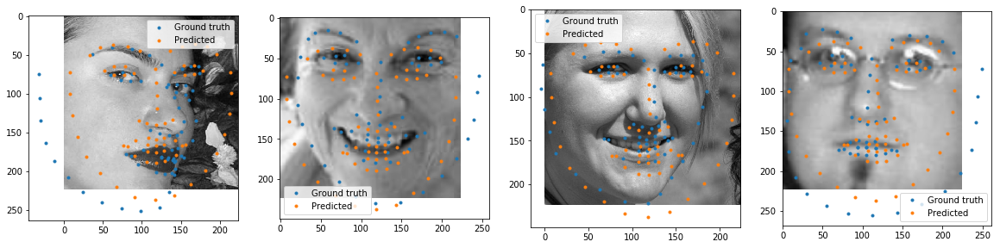

Epoch #36: train_loss = 311.99


Some test photos


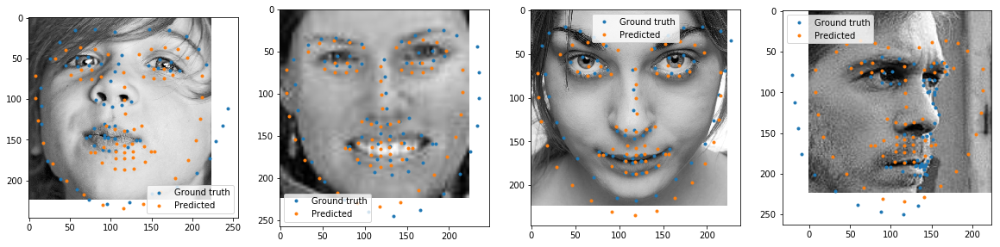

Epoch #36: test_loss = 322.33
Starting epoch #37!


5 batch loss = 297.47
10 batch loss = 312.54
15 batch loss = 337.63
20 batch loss = 296.86
25 batch loss = 324.38
Some train photos


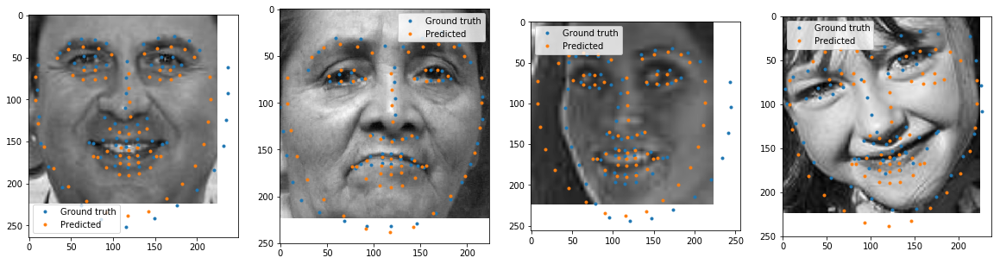

Epoch #37: train_loss = 311.81


Some test photos


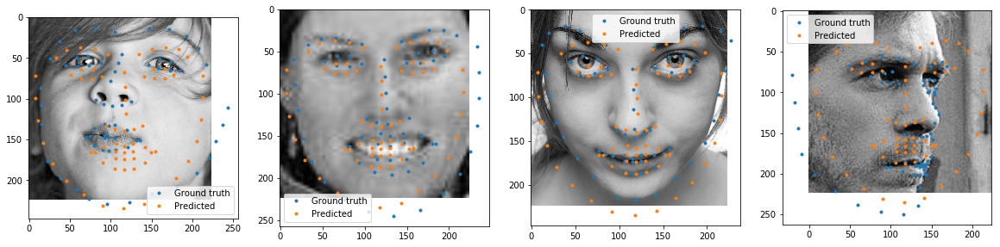

Epoch #37: test_loss = 322.68
Starting epoch #38!


5 batch loss = 313.57
10 batch loss = 324.51
15 batch loss = 313.03
20 batch loss = 310.04
25 batch loss = 290.52
Some train photos


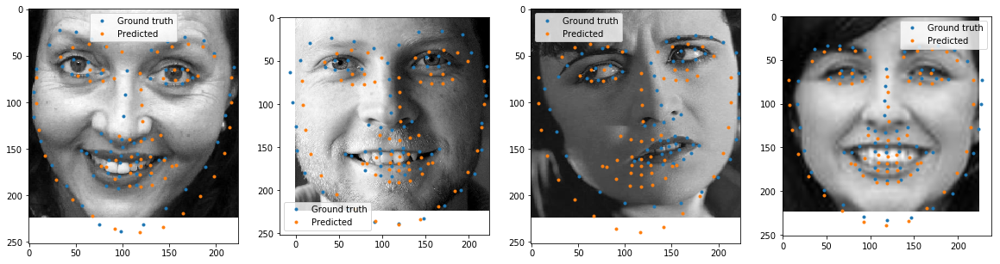

Epoch #38: train_loss = 311.80


Some test photos


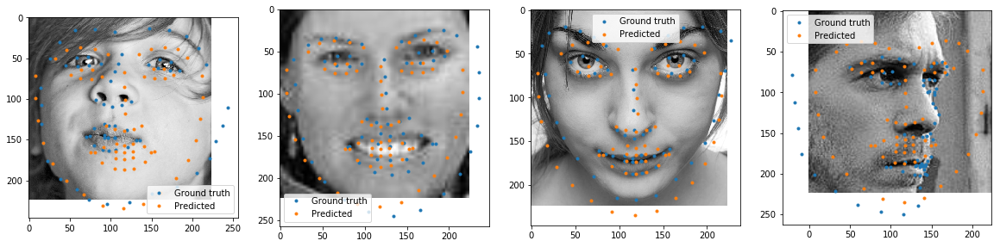

Epoch #38: test_loss = 322.39
Starting epoch #39!


5 batch loss = 316.63
10 batch loss = 301.77
15 batch loss = 290.80
20 batch loss = 297.73
25 batch loss = 315.86
Some train photos


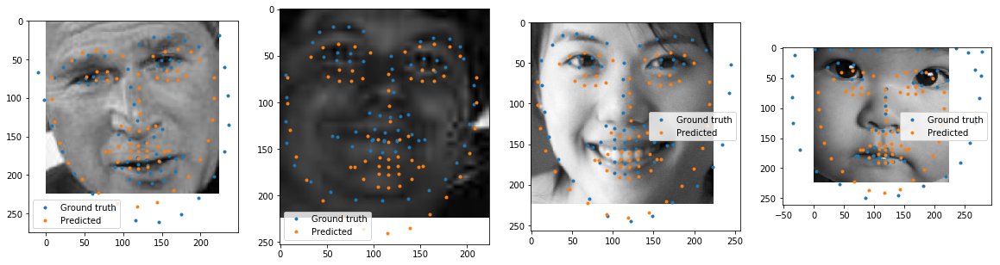

Epoch #39: train_loss = 311.85


Some test photos


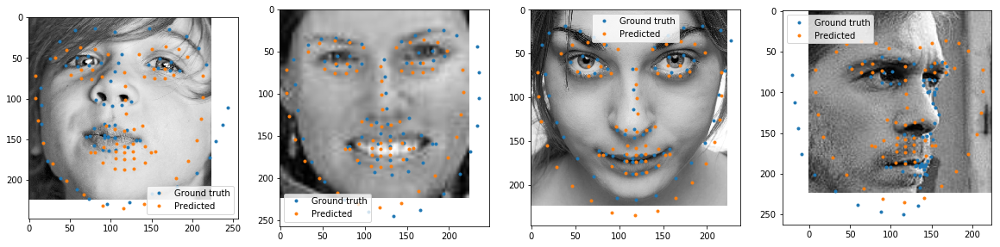

Epoch #39: test_loss = 322.73
Starting epoch #40!


5 batch loss = 313.16
10 batch loss = 316.65
15 batch loss = 322.52
20 batch loss = 297.17
25 batch loss = 328.28
Some train photos


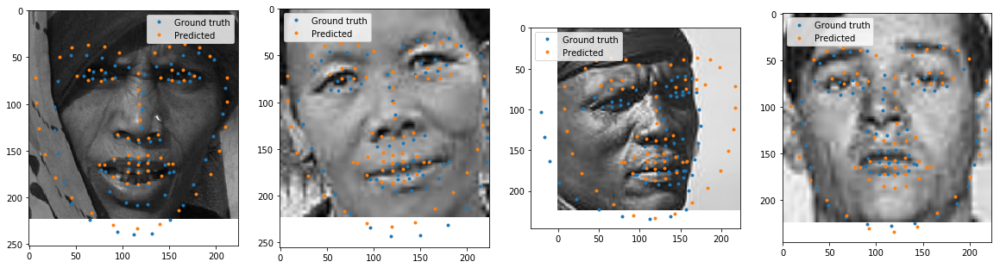

Epoch #40: train_loss = 311.77


Some test photos


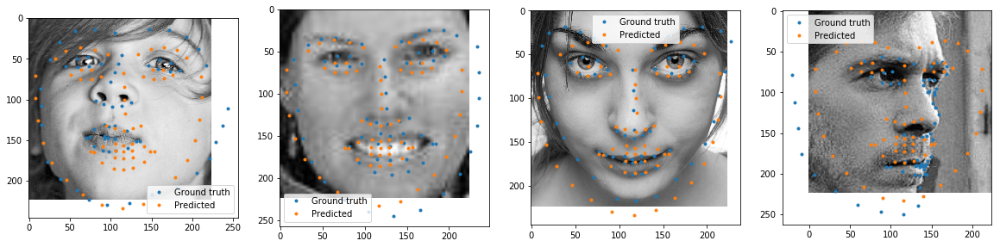

Epoch #40: test_loss = 322.30
lr decreased twice
Starting epoch #41!


5 batch loss = 295.55
10 batch loss = 330.08
15 batch loss = 312.80
20 batch loss = 314.17
25 batch loss = 304.64
Some train photos


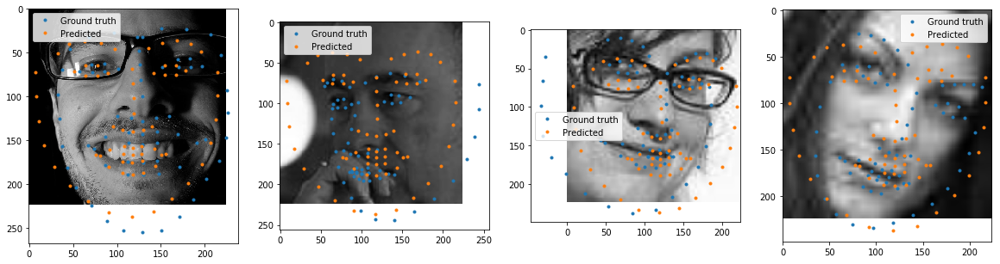

Epoch #41: train_loss = 311.75


Some test photos


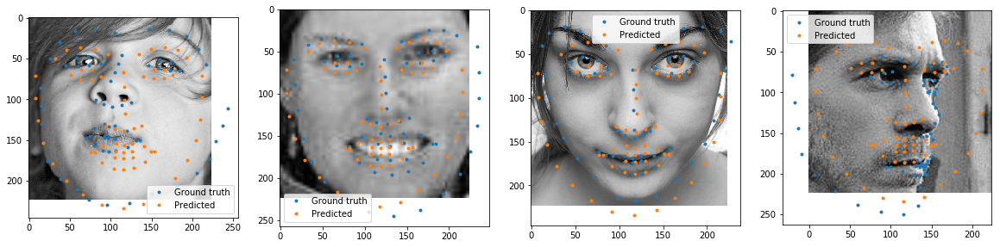

Epoch #41: test_loss = 322.22
Starting epoch #42!


5 batch loss = 320.99
10 batch loss = 333.21
15 batch loss = 312.20
20 batch loss = 299.29
25 batch loss = 334.47
Some train photos


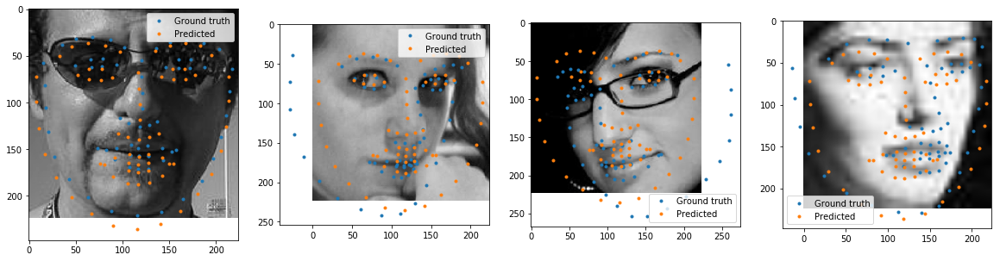

Epoch #42: train_loss = 311.81


Some test photos


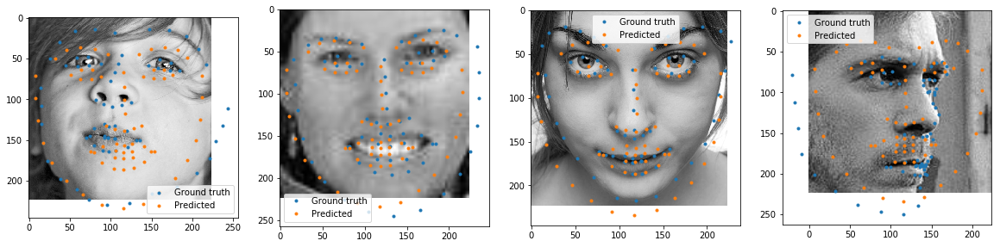

Epoch #42: test_loss = 322.26
Starting epoch #43!


5 batch loss = 307.14
10 batch loss = 295.88
15 batch loss = 325.38
20 batch loss = 317.77
25 batch loss = 297.77
Some train photos


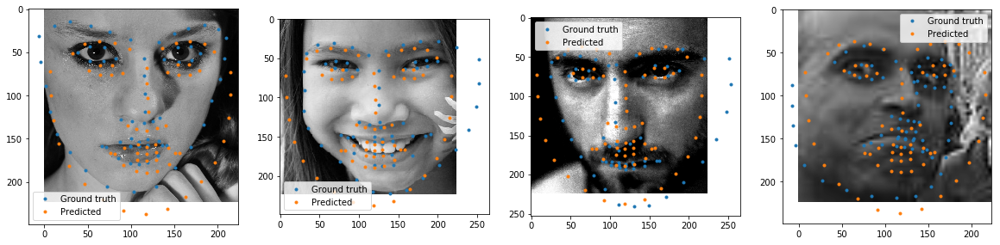

Epoch #43: train_loss = 312.02


Some test photos


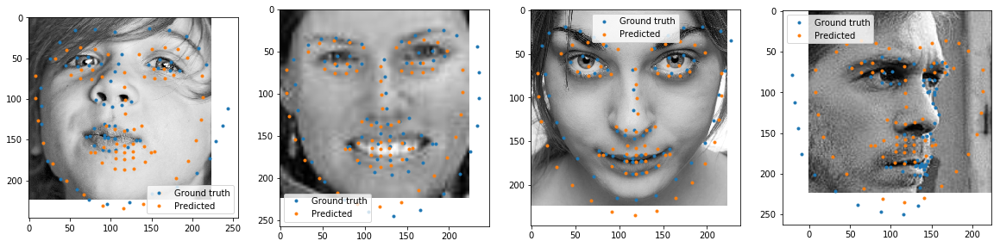

Epoch #43: test_loss = 322.36
Starting epoch #44!


5 batch loss = 311.68
10 batch loss = 320.04
15 batch loss = 318.86
20 batch loss = 285.54
25 batch loss = 315.36
Some train photos


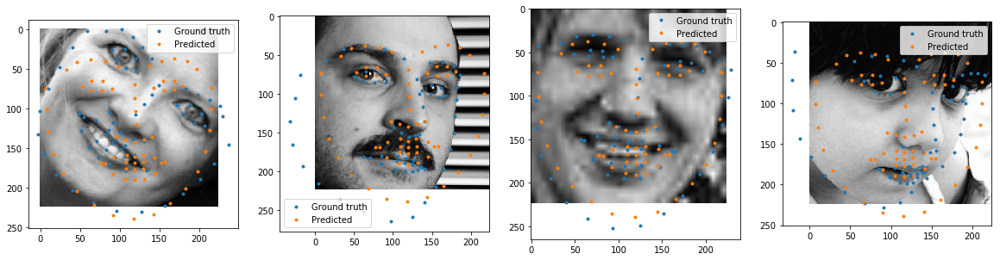

Epoch #44: train_loss = 311.86


Some test photos


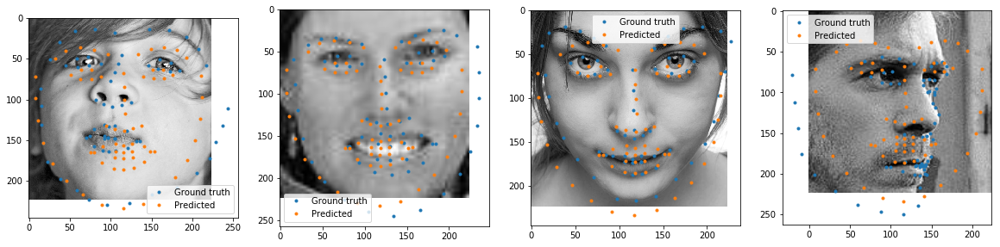

Epoch #44: test_loss = 322.25
Starting epoch #45!


5 batch loss = 310.83
10 batch loss = 302.20
15 batch loss = 299.83
20 batch loss = 308.07
25 batch loss = 321.89
Some train photos


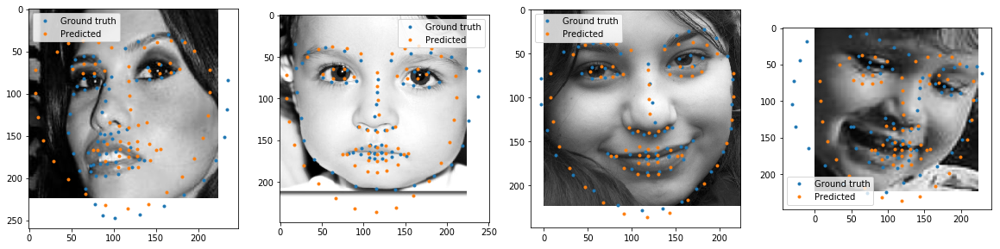

Epoch #45: train_loss = 311.81


Some test photos


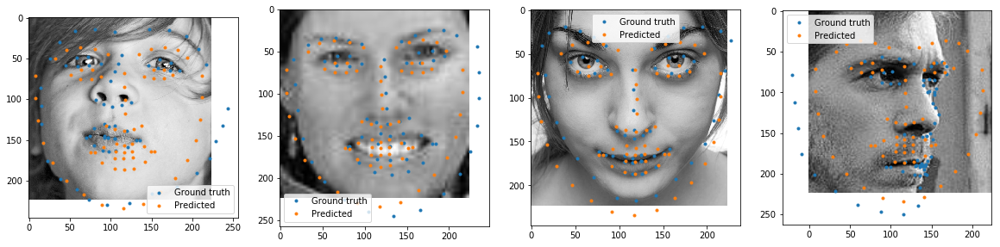

Epoch #45: test_loss = 322.21
Starting epoch #46!


5 batch loss = 329.01
10 batch loss = 310.58
15 batch loss = 287.52
20 batch loss = 300.71
25 batch loss = 317.85
Some train photos


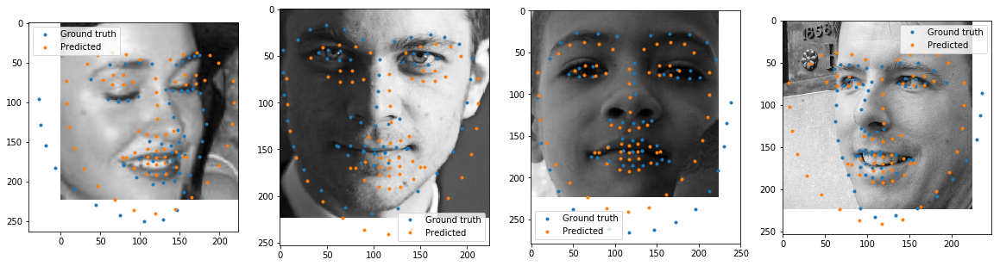

Epoch #46: train_loss = 311.67


Some test photos


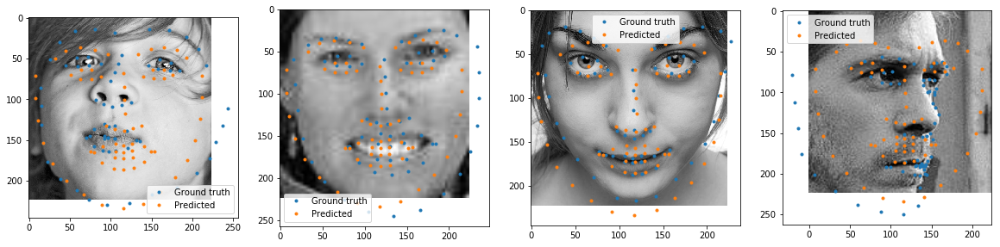

Epoch #46: test_loss = 322.21
Starting epoch #47!


5 batch loss = 323.76
10 batch loss = 321.02
15 batch loss = 304.48
20 batch loss = 308.34
25 batch loss = 335.98
Some train photos


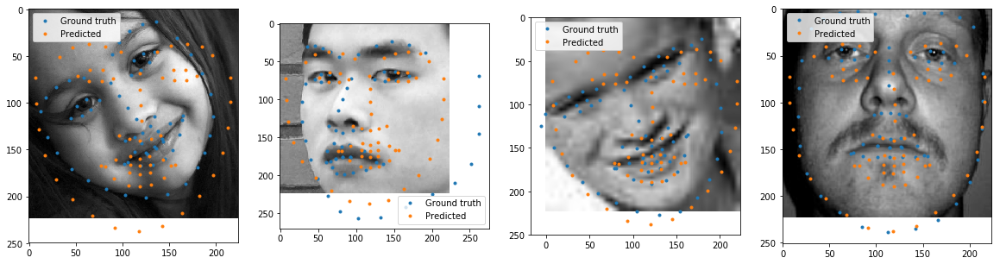

Epoch #47: train_loss = 311.81


Some test photos


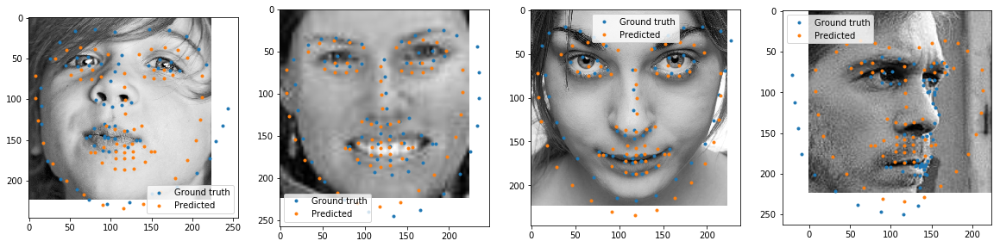

Epoch #47: test_loss = 322.21
lr decreased twice
Starting epoch #48!


5 batch loss = 315.07
10 batch loss = 300.54
15 batch loss = 321.13
20 batch loss = 288.54
25 batch loss = 305.82
Some train photos


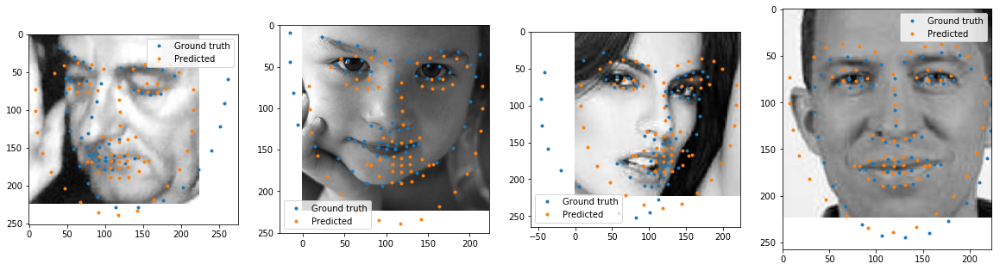

Epoch #48: train_loss = 311.74


Some test photos


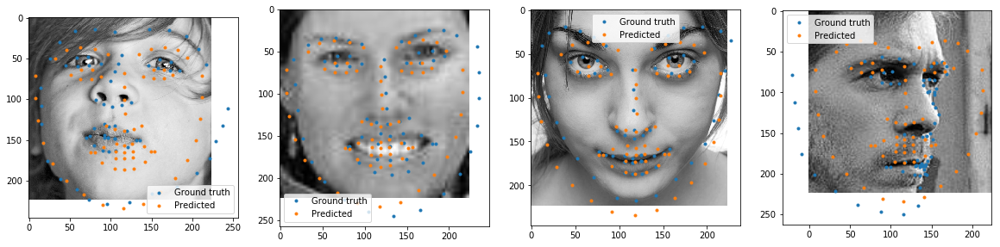

Epoch #48: test_loss = 322.20
Starting epoch #49!


5 batch loss = 298.33
10 batch loss = 304.55
15 batch loss = 306.27
20 batch loss = 303.45
25 batch loss = 299.86
Some train photos


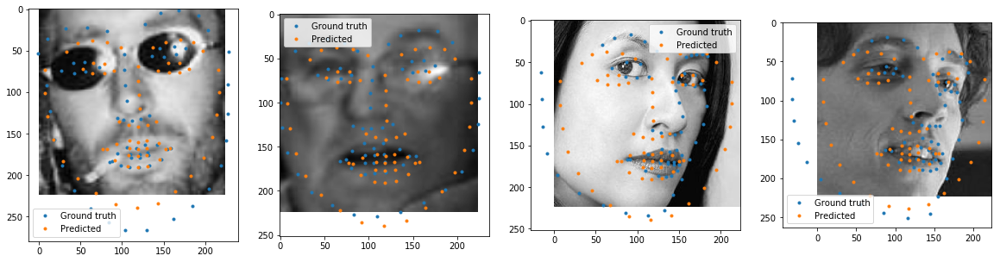

Epoch #49: train_loss = 311.75


Some test photos


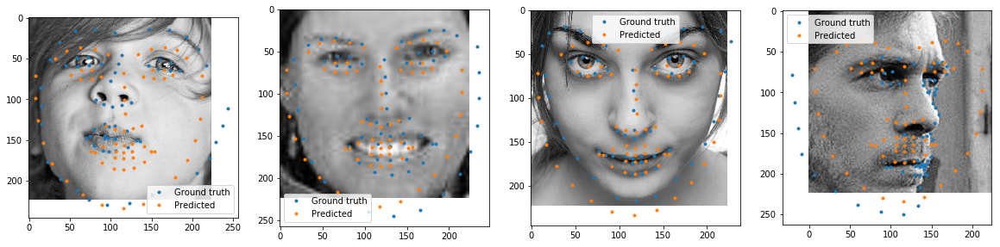

Epoch #49: test_loss = 322.19


In [186]:
train_loss_epoch = []
test_loss_epoch = []

for epoch in tqdm_notebook(range(N_EPOCHS)):

    # Обучение
    if (epoch + 1) % 7 == 0:
        for g in opt.param_groups:
            g['lr'] /= 2
            print("lr decreased twice")

    model.train()
    train_loss = []
    print("Starting epoch #%i!" % epoch)
    for n_batch, (X_batch, y_batch) in tqdm_notebook(enumerate(iterate_batches(train_img_paths, train_pts, 
                                                                               BATCH_SIZE, shuffle=True))):
        X_batch_images = []
        y_batch_transformed = np.copy(y_batch)
        for k, img_name in enumerate(X_batch):
            img = imread(CROPPED_IMG_PATH + "train/" + img_name)

            # Все изображения должны быть в формате "uint8" для корректной работы детектора
            img = img2gray_uint(img)

            # Сдвигаем координаты ключевых точек в зависимости от координат прямоугольника
            y_batch_transformed[k] -= shifts_train[CROPPED_IMG_PATH + "train/" + img_name][::-1]

            # Приводим все вырезанные изодражения к одному размеру и соответственно изменяем координаты точек
            X_batch_images.append(torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0))
            y_scale = img.shape[0] / H  
            x_scale = img.shape[1] / W 
            y_batch_transformed[k] /= [x_scale, y_scale]

        X_batch_images = torch.stack(X_batch_images)
        output = model(X_batch_images.cuda())

        loss = mseloss(output, torch.Tensor(list(map(lambda x: x.flatten(), y_batch_transformed))).cuda())
        if (n_batch + 1) % 5 == 0:
            print("%i batch loss = %.2f" % ((n_batch + 1), loss.cpu().item()))

        opt.zero_grad()
        loss.backward()
        opt.step()

        train_loss.append(loss)

    print("Some train photos")
    n_imgs_to_evaluate = min([4, len(X_batch_images)])
    fig, axes = plt.subplots(1, n_imgs_to_evaluate, figsize=(n_imgs_to_evaluate * 5, n_imgs_to_evaluate * 5))
    visualize_results(X_batch_images, y_batch_transformed, output, axes, n_imgs_to_evaluate)

    train_loss_epoch.append((sum(train_loss) / len(train_loss)).item())
    print("Epoch #%i: train_loss = %.2f" % (epoch, train_loss_epoch[-1]))

    # Тестирование
    model.train(False)
    test_loss = []
    for n_batch_test, (X_batch_test, y_batch_test) in tqdm_notebook(enumerate(iterate_batches(test_img_paths, test_pts, 
                                                                                              BATCH_SIZE))):
        with torch.no_grad():
            X_batch_test_images = []
            y_batch_test_transformed = np.copy(y_batch_test)
            for k, img_name in enumerate(X_batch_test):
                img = imread(CROPPED_IMG_PATH + "test/" + img_name)
                img = img2gray_uint(img)

                y_batch_test_transformed[k] -= shifts_test[CROPPED_IMG_PATH + "test/" + img_name][::-1]

                X_batch_test_images.append(torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0))
                y_scale = img.shape[0] / H
                x_scale = img.shape[1] / W
                y_batch_test_transformed[k] /= [img.shape[0] / H, img.shape[1] / W]

            X_batch_test_images = torch.stack(X_batch_test_images)
            output = model(X_batch_test_images.cuda())

            loss = mseloss(output, torch.Tensor(list(map(lambda x: x.flatten(), y_batch_test_transformed))).cuda())
            test_loss.append(loss)

    # Визуализация результатов
    print("Some test photos")
    n_imgs_to_evaluate = min([4, len(X_batch_test)])
    fig, axes = plt.subplots(1, n_imgs_to_evaluate, figsize=(n_imgs_to_evaluate * 5, n_imgs_to_evaluate * 5))
    visualize_results(X_batch_test_images, y_batch_test_transformed, output, axes, n_imgs_to_evaluate)
    
    test_loss_epoch.append((sum(test_loss) / len(test_loss)).item())
    print("Epoch #%i: test_loss = %.2f" % (epoch, test_loss_epoch[-1]))
    
    # Сохранение чекпойнтов
    now = datetime.datetime.now()
    torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': opt.state_dict(),
            'train_loss': train_loss_epoch[-1],
            'test_loss': test_loss_epoch[-1]
            }, "landmarks_task/checkpoints/" + now.strftime("%Y-%m-%d_%H:%M") + "_" + str(epoch) + "ep.pth")
    
    print("============================================================")

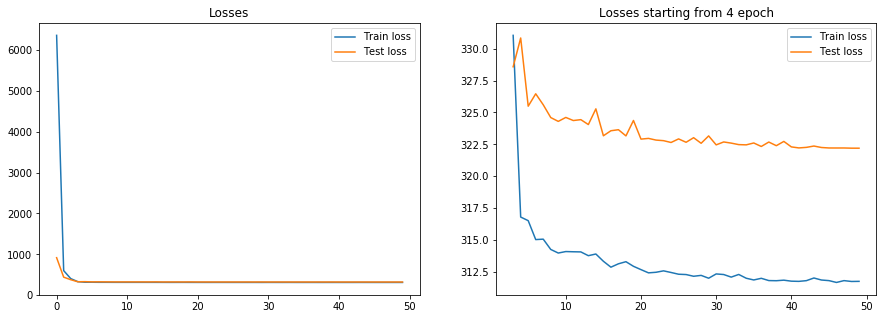

In [197]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
axes[0].plot(train_loss_epoch)
axes[0].plot(test_loss_epoch)
axes[0].legend(["Train loss", "Test loss"])
axes[0].set_title("Losses")
axes[1].plot(np.arange(3, len(train_loss_epoch)), train_loss_epoch[3:])
axes[1].plot(np.arange(3, len(train_loss_epoch)), test_loss_epoch[3:])
axes[1].legend(["Train loss", "Test loss"])
axes[1].set_title("Losses starting from 4 epoch")
plt.show()

## Подсчет метрик

**Посчитаем нормированные функции ошибок для всех тестовых изображений**

In [296]:
normed_losses = {}
for i in tqdm_notebook(range(len(test_img_paths))):
    img_name = test_img_paths[i]
    img = imread(CROPPED_IMG_PATH + "test/" + img_name)
    img = img2gray_uint(img)
    y = np.copy(test_pts[i])

    y -= shifts_test[CROPPED_IMG_PATH + "test/" + img_name][::-1]

    X = torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0).unsqueeze(0)
    y_scale = img.shape[0] / H
    x_scale = img.shape[1] / W
    y /= [y_scale, x_scale]

    output = model(X.cuda())

    output = output.cpu().detach().numpy().reshape((68, 2))
    
    gt = y * [y_scale, x_scale]
    gt_x = gt[:, 0]
    gt_y = gt[:, 1]
    
    predicted = output * [y_scale, x_scale]
    predicted_x = predicted[:, 0]
    predicted_y = predicted[:, 1]
    
    n_samples = len(y)
    normalization_factor = np.sqrt(img.shape[0] * img.shape[1])
    
    normed_losses[img_name] = np.sum(np.sqrt((gt_x - predicted_x) ** 2 + (gt_y - predicted_y) ** 2)) / \
                                    (n_samples * normalization_factor)

In [315]:
step = 0.005
discrete_losses = np.arange(0, 0.09, step)

Text(0.5, 1.0, 'CED for our model')

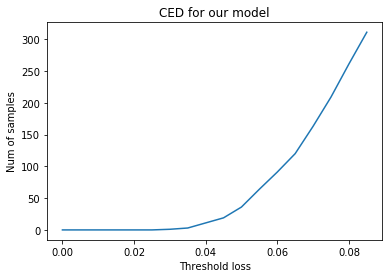

In [369]:
plt.plot(discrete_losses, list(map(lambda x: np.sum(np.array(list(normed_losses.values())) < x), discrete_losses)))
plt.ylabel("Num of samples")
plt.xlabel("Threshold loss")
plt.title("CED for our model")

In [320]:
ced_auc = 0.
for thr in discrete_losses:
    ced_auc += np.sum(np.array(list(normed_losses.values())) < thr) * step

In [323]:
print("ced_auc для полученной модели при пороге 0.08: %.2f" % ced_auc)

ced_auc для полученной модели при пороге 0.08: 6.44


**Теперь построим кривую ced для детектора**

In [346]:
def keypoints2bounding_box(kp):
    
    if kp.shape == (68, 2):
        kp = kp.reshape(-1, 136)[0]
        
    kp_x = kp[::2]
    kp_y = kp[1::2]
    
    bb = np.array([[min(kp_x), min(kp_y)],
                   [max(kp_x), max(kp_y)]])
    return bb

In [362]:
normed_losses_detector = {}
for i in tqdm_notebook(range(len(test_img_paths))):
    img_name = test_img_paths[i]
    img = imread(CROPPED_IMG_PATH + "test/" + img_name)
    img = img2gray_uint(img)
    y = np.copy(test_pts[i])

    y -= shifts_test[CROPPED_IMG_PATH + "test/" + img_name][::-1]

    X = torch.Tensor(cv2.resize(img, (H, W))).unsqueeze(0).unsqueeze(0)
    y_scale = img.shape[0] / H
    x_scale = img.shape[1] / W
    y /= [y_scale, x_scale]

    output = model(X.cuda())

    output = output.cpu().detach().numpy().reshape((68, 2))
    
    # Переводим множество ключевых точек в 2 точки, определяющие bounding box
    # Далее сравниваем эти 2 точки с 2мя точками, задающими картинку (левый верхний и правый нижний углы)
    gt = y * [y_scale, x_scale]
    gt2bb = keypoints2bounding_box(gt)
    gt2bb_x = gt2bb[:, 0]
    gt2bb_y = gt2bb[:, 1]
    
    n_samples = len(y)
    normalization_factor = np.sqrt(img.shape[0] * img.shape[1])
    
    normed_losses_detector[img_name] = np.sum(np.sqrt((gt2bb_x - [0, img.shape[0]]) ** 2 + \
                                                      (gt2bb_y - [0, img.shape[1]]) ** 2)) / \
                                                      (2 * normalization_factor)

Text(0.5, 1.0, 'CED for the detector')

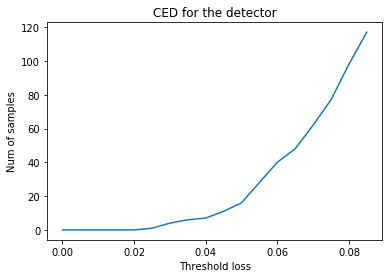

In [370]:
plt.plot(discrete_losses, list(map(lambda x: np.sum(np.array(list(normed_losses_detector.values())) < x), discrete_losses)))
plt.ylabel("Num of samples")
plt.xlabel("Threshold loss")
plt.title("CED for the detector")

In [353]:
ced_auc_detector = 0.
for thr in discrete_losses:
    ced_auc_detector += np.sum(np.array(list(normed_losses_detector.values())) < thr) * step

In [356]:
print("ced_auc для детектора при пороге 0.08: %.2f" % ced_auc_detector)

ced_auc для детектора при пороге 0.08: 2.58


**Сравнение результатов**

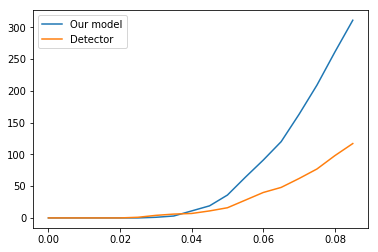

In [357]:
plt.plot(discrete_losses, list(map(lambda x: np.sum(np.array(list(normed_losses.values())) < x), discrete_losses)))
plt.plot(discrete_losses, list(map(lambda x: np.sum(np.array(list(normed_losses_detector.values())) < x), discrete_losses)))
plt.legend(["Our model", "Detector"])
plt.show()

**Видно, что наша модель имеет бОльшую площадь под графиком => она позволяет находить более точный bounding box для лица на изображении**

**Стоит заметить, что в некоторых случаях детектор срабатывал неверно. В основном это связано с нахождением всего одного лица на фотографиях, где этих лиц несколько. Такие примеры были найдены и удалены из датасета**

В отчёте по результатам выполнения тестового задания должны быть:

- код для обучения и тестирования модели

- скрипт, позволяющий минимальными усилиями воспроизвести результат (запустить обучение и тестирование) и документация к нему

- отчёт в формате pdf с описанием проделанных экспериментов (какие подходы были проверены, какие результаты и выводы были сделаны и т.д.). В отчёте помимо описания проделанных экспериментов нужно вставить графики по метрике CED (cummulative error distribution), по оси X в которых идёт нормированная среднеквадратичная ошибка, а по оси Y - процент изображений в тестовой выборке, ошибка на которых меньше значения по оси X. Максимальное значение ошибки по оси X взять равным 0.08. Нормализацию ошибки нужно производить на величину sqrt(H * W), где H, W - высота и ширина прямоугольника лица, полученного с помощью DLIB. Ошибку нужно считать в координатах исходного изображения. Для каждого графика CED необходимо посчитать площадь под кривой - это будет целевая метрика для сравнения алгоритмов. Графики CED должны быть построены отдельно для датасетов 300W и Menpo. Помимо предложенного метода нужно отобразить на графике точность работы детектора точек DLIB для базы Menpo (детектор dlib обучался на базе 300W, поэтому тестировать dlib на ней не имеет смысла). Пример использования http://dlib.net/face_landmark_detection.py.html

Пример скрипта для подсчёта CED графиков можно найти тут: https://drive.google.com/file/d/0B8okgV6zu3CCTk96SW9IWFJ6RE0/view?usp=sharing

Минимальный результат - предложенный алгоритм должен быть близок к DLIB по площади под CED графиком при пороге 0.08.